Visualisation of Forest change between 2000 and 2019 using the [Hansen dataset](https://developers.google.com/earth-engine/datasets/catalog/UMD_hansen_global_forest_change_2019_v1_7). Forest loss during the study period, defined as a stand-replacement disturbance (a change from a forest to non-forest state). The tree canopy cover for year 2000 is defined as canopy closure for all vegetation taller than 5m in height.

Forest loss during the study period, defined as a stand-replacement disturbance, or a change from a forest to non-forest state. Encoded as either 0 (no loss) or else a value in the range 1–19, representing loss detected primarily in the year 2001–2019, respectively.







## Imports

In [ ]:
!pip install Unidecode && pip install rasterio

In [2]:
import ee
import time
import sys
from unidecode import unidecode
import argparse
import os.path
import matplotlib.pyplot as plt
import glob
import rasterio
import cv2
from numba import jit
import pandas as pd
import matplotlib

In [3]:
#initialize google earth engine
try:
  ee.Initialize()
except:
  ee.Authenticate()
  ee.Initialize()

# Functions

In [4]:
def export_to_cloud(img, fname, folder, expregion, eeuser=None, scale=10):
  task = ee.batch.Export.image.toDrive(**{
      'image': img.clip(expregion),
      'description':fname, 
      'folder':folder, 
      'fileNamePrefix':fname, 
      'dimensions':None, 
      'region':expregion.geometry().bounds().getInfo()['coordinates'],
      'scale':scale, 
      'crs':'EPSG:4326', 
      'crsTransform':None, 
      'maxPixels':1e13
  })
  task.start()
  while task.status()['state'] == 'RUNNING':
    print('Running...')
    time.sleep(20)
  print('Done.'.format(task.status()))
  time.sleep(10)

In [5]:
def export_global_forest_change_image(collection, folder_name_drive, scale=100):
    # Shapefile features to feature list 
    county_region = ee.FeatureCollection(collection)
    feature_list_computed = county_region.toList(1e5).getInfo()

    # Get Image with bands treecover2000 & lossyear
    # https://developers.google.com/earth-engine/datasets/catalog/UMD_hansen_global_forest_change_2019_v1_7
    ee_image = 'UMD/hansen/global_forest_change_2019_v1_7'
    img = ee.Image(ee_image).select('treecover2000', 'lossyear') 

    # Export images to cloud
    for idx, region in enumerate(feature_list_computed):
      key = name_counties(region)
      print("{}: {}".format(idx, key))
      export_to_cloud(img, key, folder_name_drive, ee.Feature(region), scale=scale)

In [6]:
def export_landcover_Copernicus_tree_coverage_image(collection, folder_name_drive, scale=100):
  get_name = lambda r, l: unidecode(r.get('properties').get(l)).lower().translate("'()/&-").strip()
  name_counties = lambda region: get_name(region, 'NAME_1') 
  # Shapefile features to feature list 
  county_region = ee.FeatureCollection(collection)
  feature_list_computed = county_region.toList(1e5).getInfo()
  years_copernicus = [2015,2016,2017,2018,2019]
  # Get Image with bands tree cover fraction
  for year in years_copernicus:
    ee_image = 'COPERNICUS/Landcover/100m/Proba-V-C3/Global/{}'.format(year) 
    print(ee_image)
    img = ee.Image(ee_image).select('tree-coverfraction') 

    # Export images to cloud
    for idx, region in enumerate(feature_list_computed):
      key = name_counties(region) + "_{}".format(year)
      print("{}: {}".format(idx, key))
      export_to_cloud(img, key, folder_name_drive, ee.Feature(region), scale=scale)

In [7]:
def get_loss_per_year(all_imgs):
  count_per_year = []
  for img in all_imgs:
    count_i = []
    for i in range(1,20):
      # adding all pixels for the year i
      # https://help.arcgis.com/en/arcims/10.0/mainhelp/mergedProjects/ArcXMLGuide/elements/layerinfo.htm#:~:text=To%20calculate%20the%20number%20of,the%20scale%20is%20in%20feet
      # 1 pixel = (0.001347472926179282306*111.195)^2 = 0.022 km2 (cartesian calculation)
      count_i.append(((0.001347472926179282306*111.195)*(0.001347472926179282306*111.195))*len(img[img == i]))
    count_per_year.append(count_i)
  print(len(count_i))
  return count_per_year

In [8]:
def display_bands_image_hansen_dataset(img_path, save=False, name="name_to_save.png"):
  # Read and display image
  img = rasterio.open(img_path).read()
  fig, (ax1, ax2) = plt.subplots(figsize=(15, 7), ncols=2)
  pos = ax1.imshow(img[0], cmap='Greens')
  ax1.title.set_text('Percentage Tree cover in 2000')
  ax1.axis('off')
  fig.colorbar(pos, ax=ax1)
  legend = ['no_loss', '2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017','2018','2019']
  colors = ['black', '#f2e889','#e7d62a','#F2CC1C','#FEB92A','#FEA83B','#F29A4B','#DE7A5E','#CC6860','#DF6264', "#CC5072", "#E03C83","#CC1880","#CA2A6D","#CF205D","#C8104C","#C10B44","#B51940","#AE1139","#9F1E31"]
  ax2.axis('off')
  pos2 = ax2.imshow(img[1], cmap=matplotlib.colors.ListedColormap(colors=colors))
  ax2.title.set_text('Tree cover loss over the years 2000-2019')
  cbar = fig.colorbar(pos2, ax=ax2, label="Years", ticks=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19])
  cbar.ax.set_yticklabels(legend)
  plt.show()
  if save:
    fig.savefig(name)

In [9]:
def display_overlayed_treecover2000_treelossyears(img_path, save=False, name="name_to_save.png"):
  img = rasterio.open(img_path).read()
  fig, ax = plt.subplots(figsize=(12,10))
  plt.title("Percentage Tree cover in 2000 and Tree cover loss over the years 2000-2019 overlayed")
  plt.axis('off')
  plt.imshow(img[0], cmap="Greens")
  colors = ['none', '#f2e889','#e7d62a','#F2CC1C','#FEB92A','#FEA83B','#F29A4B','#DE7A5E','#CC6860','#DF6264', "#CC5072", "#E03C83","#CC1880","#CA2A6D","#CF205D","#C8104C","#C10B44","#B51940","#AE1139","#9F1E31"]
  pos = plt.imshow(img[1], alpha=0.8, cmap=matplotlib.colors.ListedColormap(colors=colors))
  legend = ['no_loss', '2001','2002','2003','2004','2005','2006','2007','2008','2009','2010','2011','2012','2013','2014','2015','2016','2017','2018','2019']
  cbar = fig.colorbar(pos, ax=ax, label="Years", ticks=[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19])
  cbar.ax.set_yticklabels(legend)
  plt.show()
  if save:
    fig.savefig(name)

# State level

In [10]:
folder_drive_name_state = "global_forest_change_hansen_state"
# using shapefile from GADM 
# and saved in github: https://github.com/MargauxMasson/GIS_shapefiles/tree/main/USA_states 
collection = 'users/margauxmasson21/Oregon_state'
global_forest_change_hansen_state_exported = True

get_name = lambda r, l: unidecode(r.get('properties').get(l)).lower().translate("'()/&-").strip()
name_counties = lambda region: get_name(region, 'NAME_1') 

### Export/Load Image in Drive

In [11]:
if not global_forest_change_hansen_state_exported:
  export_global_forest_change_image(collection, 
                                    folder_drive_name, 
                                    scale=150)

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
path_drive_state = '/content/drive/MyDrive/' + folder_drive_name_state
imgs_paths_state = glob.glob(path_drive_state + "/*.tif")
if len(imgs_paths_state) == 0:
  print("Please, wait until tif is downloaded in your Drive, and re try")
else:
  print(len(imgs_paths_state))

1


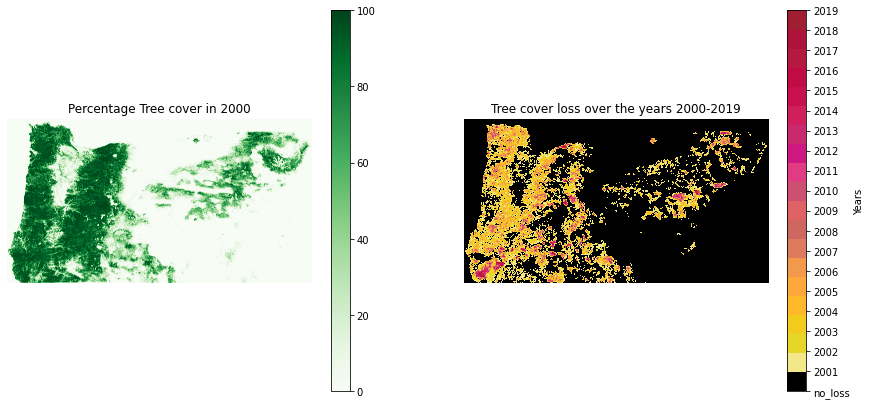

In [14]:
display_bands_image_hansen_dataset(imgs_paths_state[0])

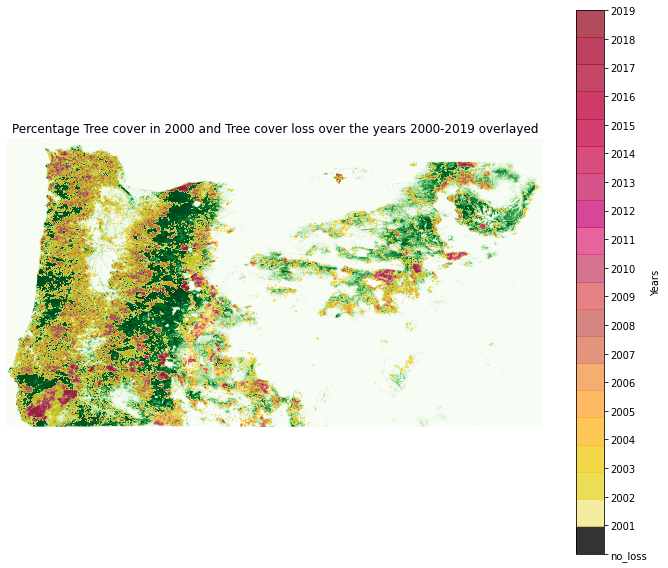

In [15]:
display_overlayed_treecover2000_treelossyears(imgs_paths_state[0], save=True, name="Oregon_overlayed.png")

In [16]:
img_oregon = rasterio.open(imgs_paths_state[0]).read()
count_tree_loss_per_year_country = get_loss_per_year([img_oregon])
years = [i for i in range(2001,2020)]
count_per_year_country_pd = pd.DataFrame(count_tree_loss_per_year_country, columns=years) 
count_per_year_country_pd.head(10)

19


,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,9137.366171,8773.119727,5306.638522,6427.103236,4262.5926,4344.713616,3886.290665,3850.573187,3178.496406,3437.453738,3383.147905,3606.612256,3411.771277,4010.886521,3428.9902,4257.24957,4312.655439,4592.580795,4104.703833


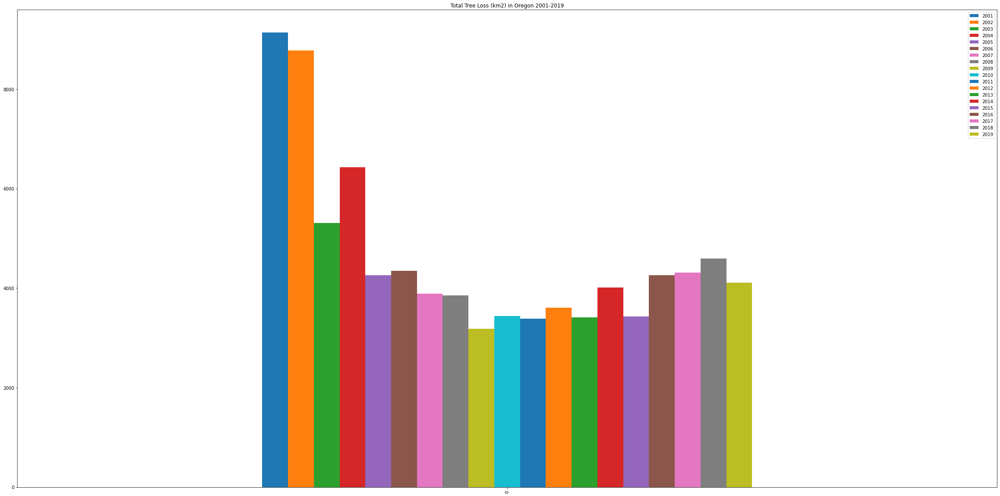

In [17]:
fig = count_per_year_country_pd.plot.bar(figsize=(40, 20), title="Total Tree Loss (km2) in Oregon 2001-2019").get_figure()
fig.savefig('Total_Tree_Loss_Oregon_2001_2019.png')

# Counties Level

### Export/Load images in Drive 

In [18]:
folder_drive_name_counties = "global_forest_change_hansen_counties"
# using shapefile from https://navigator.blm.gov/data?id=2091c3982605fbec 
collection_counties = 'users/margauxmasson21/oregon_counties'
global_forest_change_hansen_counties_exported = True

get_name = lambda r, l: unidecode(r.get('properties').get(l)).lower().translate("'()/&-").strip()
name_counties = lambda region: get_name(region, 'NAME_1') + "_" +  get_name(region, 'NAME_2')

In [19]:
if not global_forest_change_hansen_counties_exported:
  export_global_forest_change_image(collection_counties, 
                                    folder_drive_name, 
                                    scale=150)

### Get images from Drive


In [20]:
path_drive_counties = '/content/drive/MyDrive/' + folder_drive_name_counties
imgs_paths_counties = glob.glob(path_drive_counties + "/*.tif")
if len(imgs_paths_counties) == 0:
  print("wait until tif is downloaded in your Drive, and re try")
else:
  print(len(imgs_paths_counties))

36


In [21]:
# Read images
all_imgs = []
counties = []
for image_path in imgs_paths_counties:
  img = rasterio.open(image_path).read()
  all_imgs.append(img)
  counties.append(image_path.split("/")[-1].split(".tif")[0])

oregon_benton


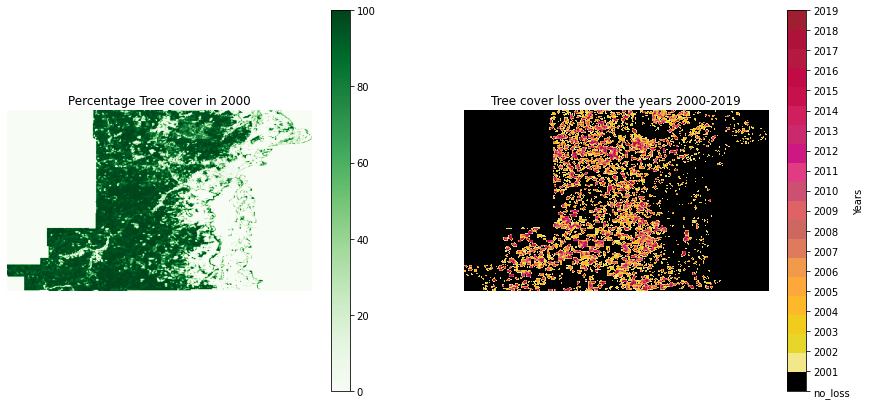

oregon_baker


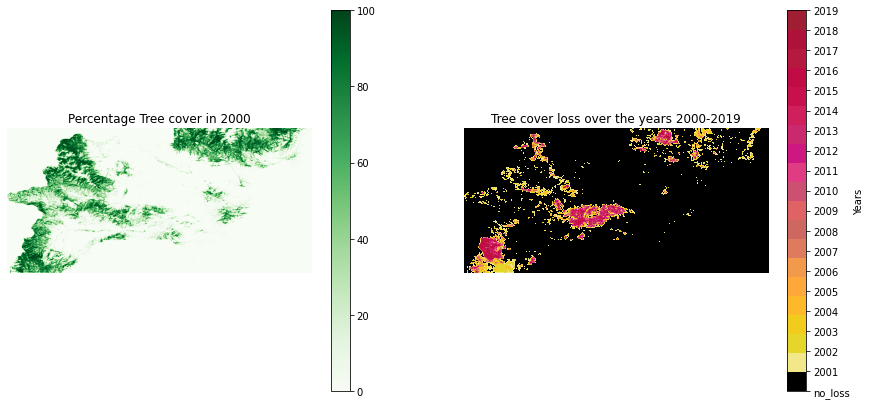

oregon_clackamas


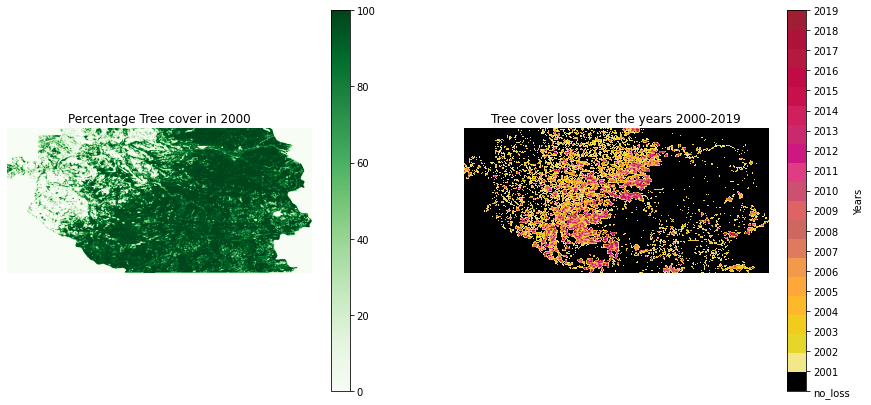

oregon_clatsop


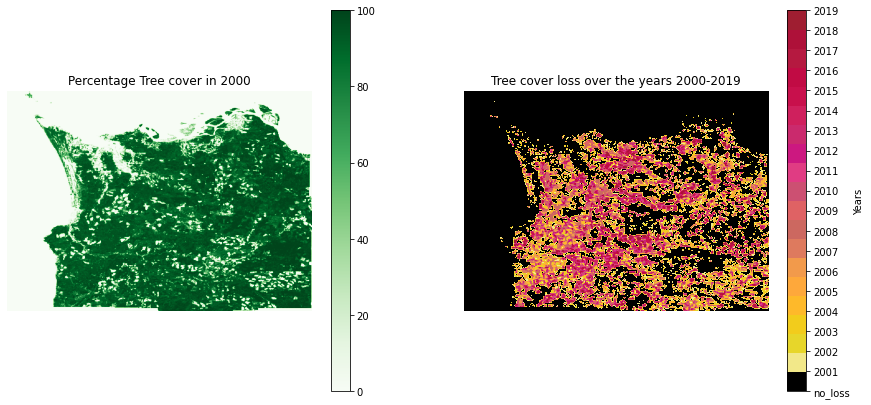

oregon_columbia


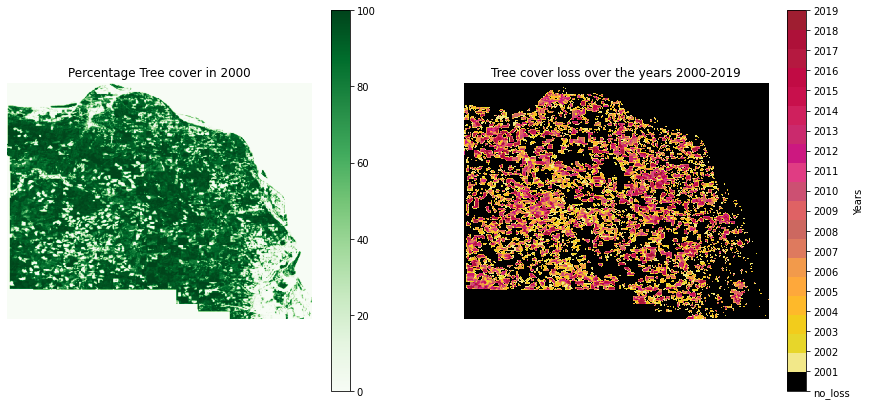

oregon_coos


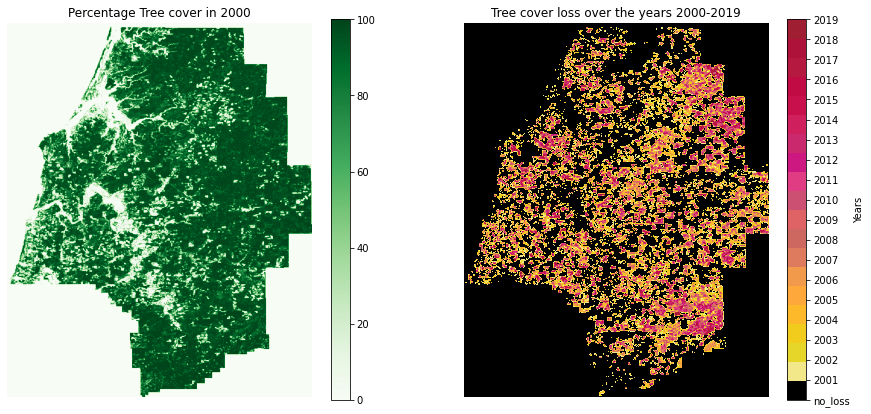

oregon_crook


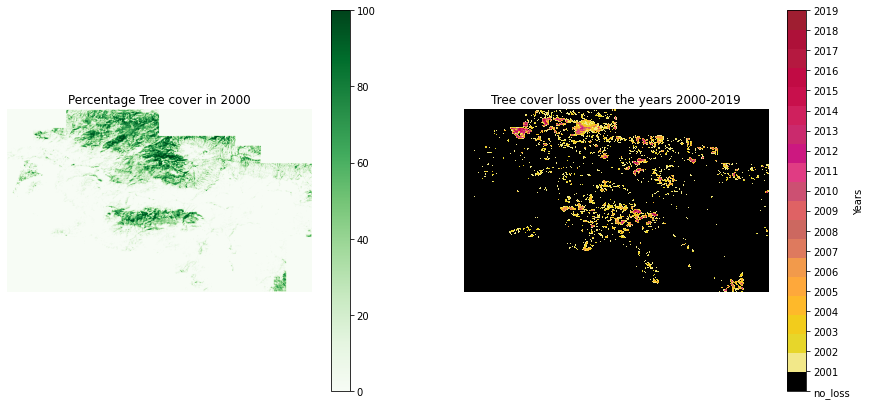

oregon_curry


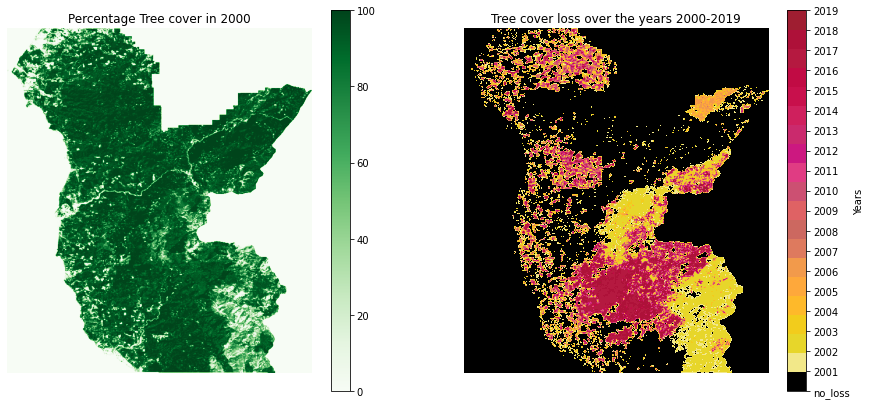

oregon_deschutes


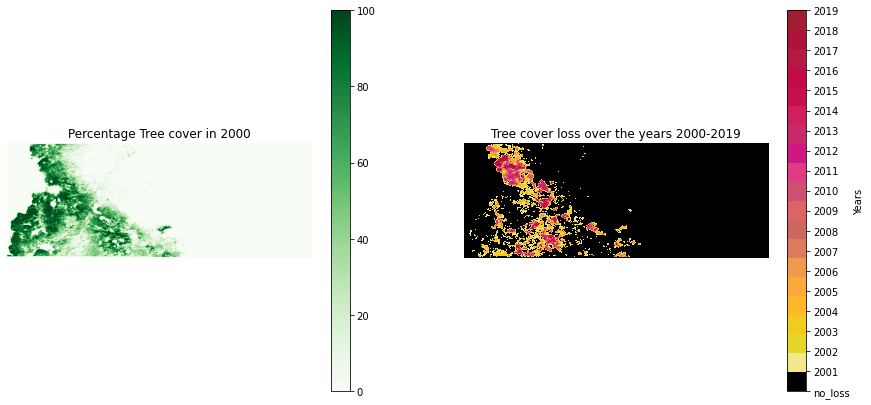

oregon_gilliam


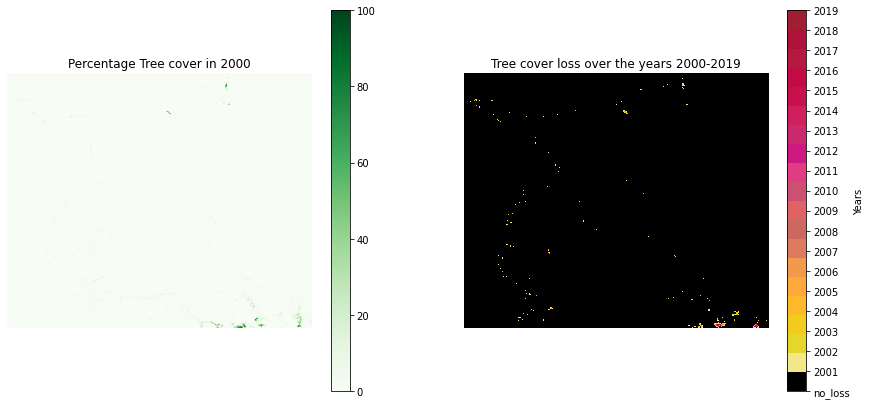

oregon_grant


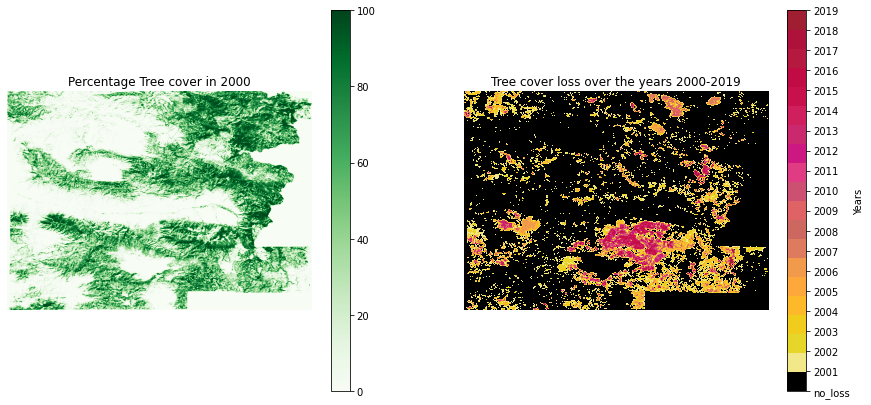

oregon_douglas


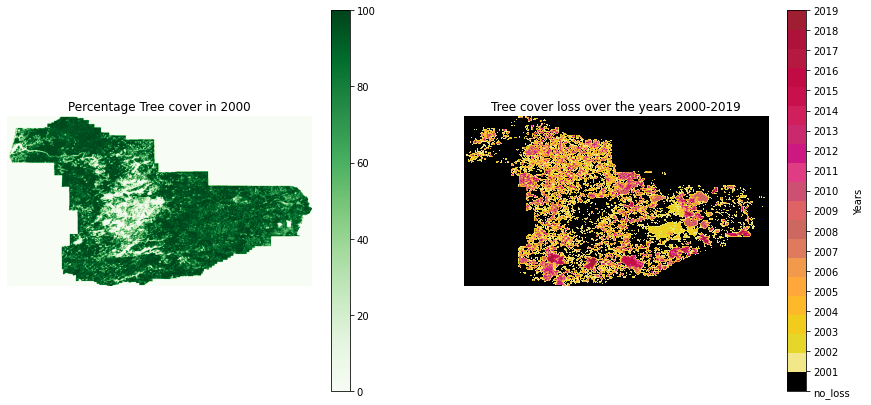

oregon_hood river


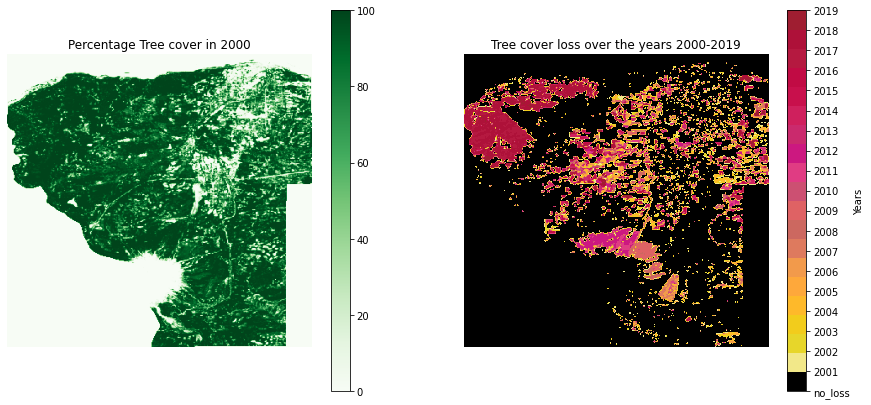

oregon_harney


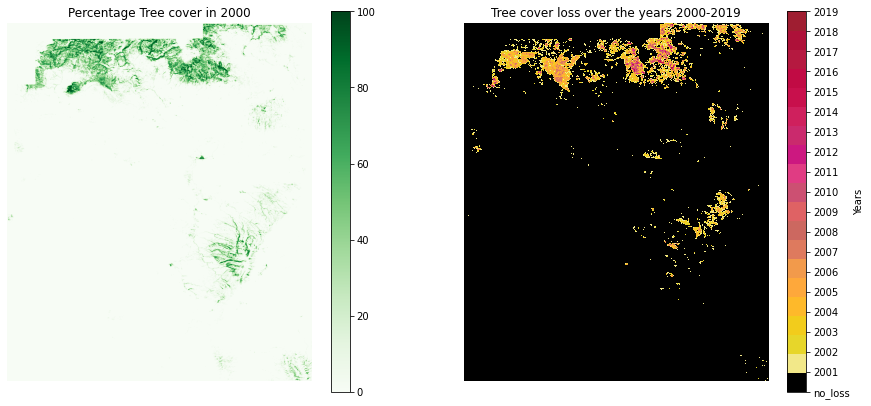

oregon_jackson


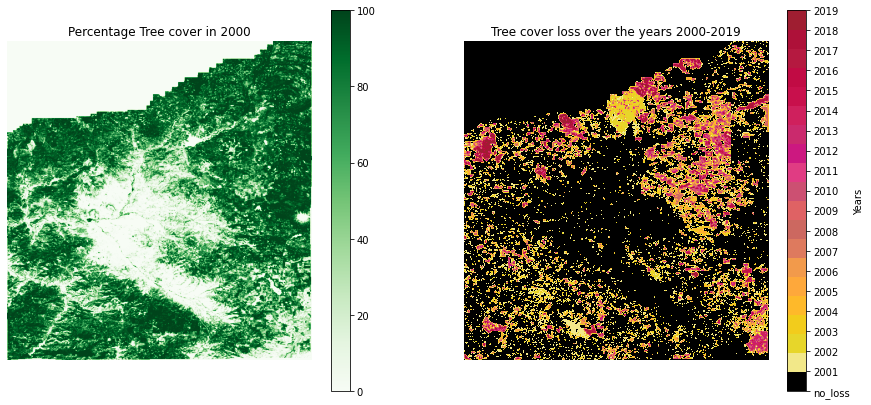

oregon_jefferson


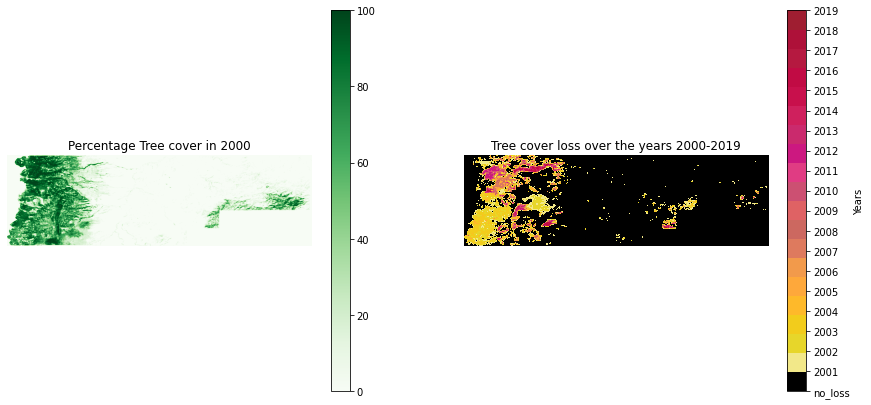

oregon_josephine


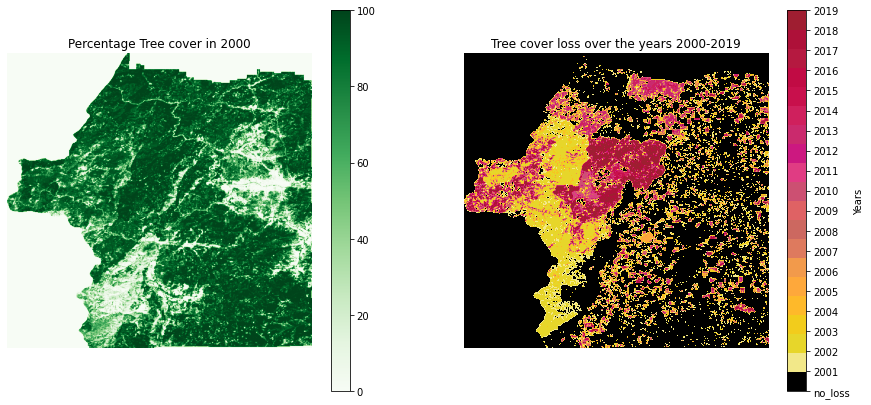

oregon_klamath


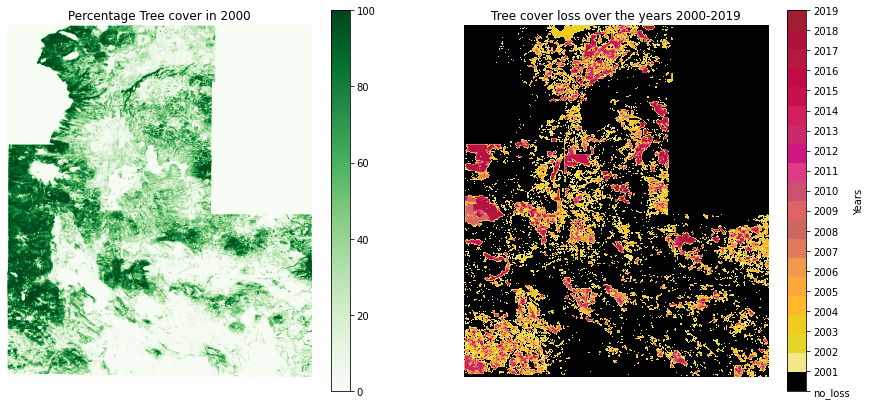

oregon_lane


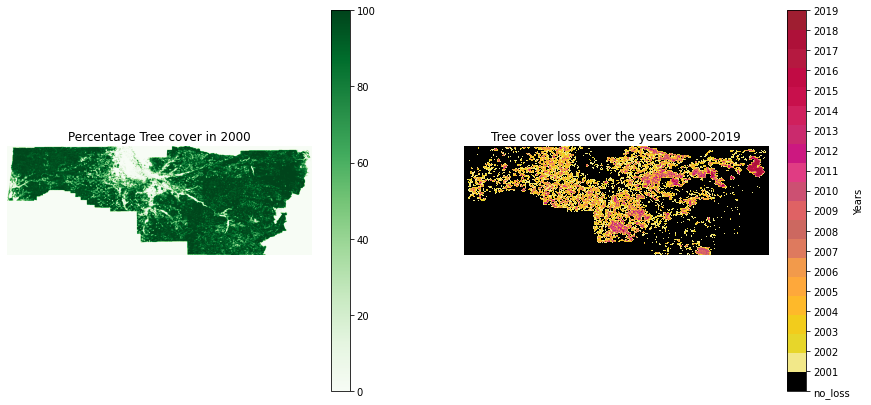

oregon_lincoln


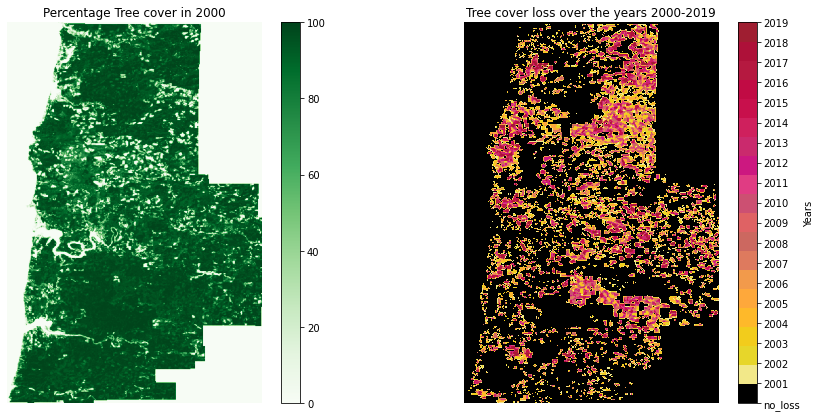

oregon_linn


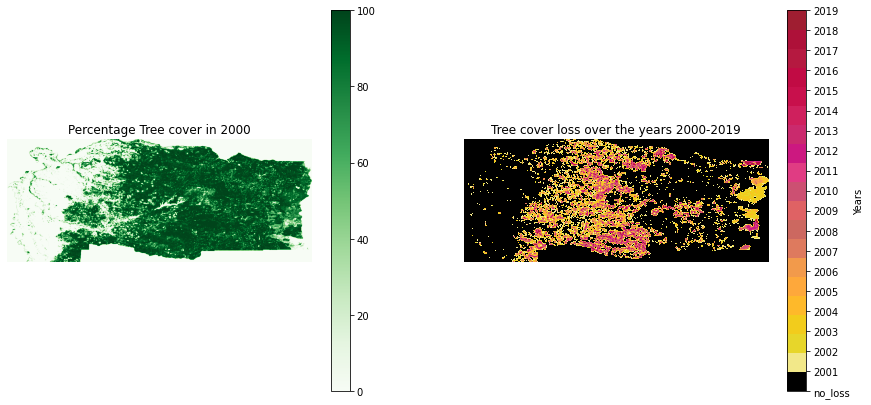

oregon_malheur


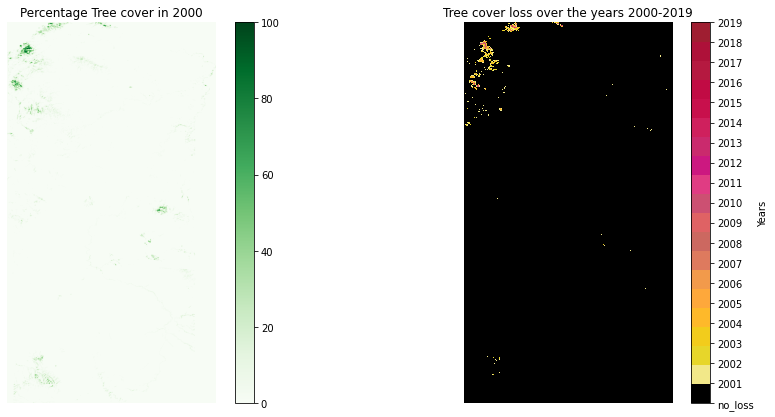

oregon_lake


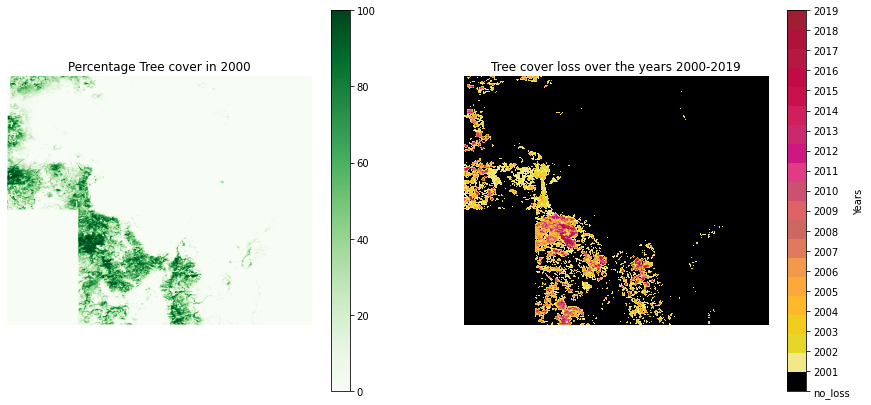

oregon_marion


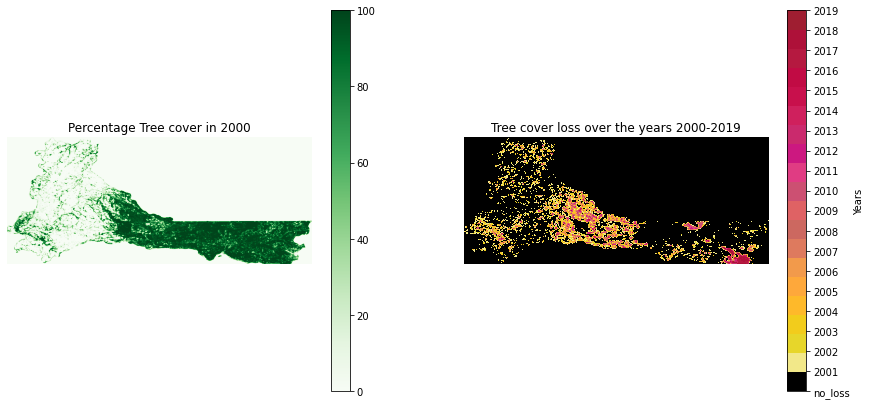

oregon_morrow


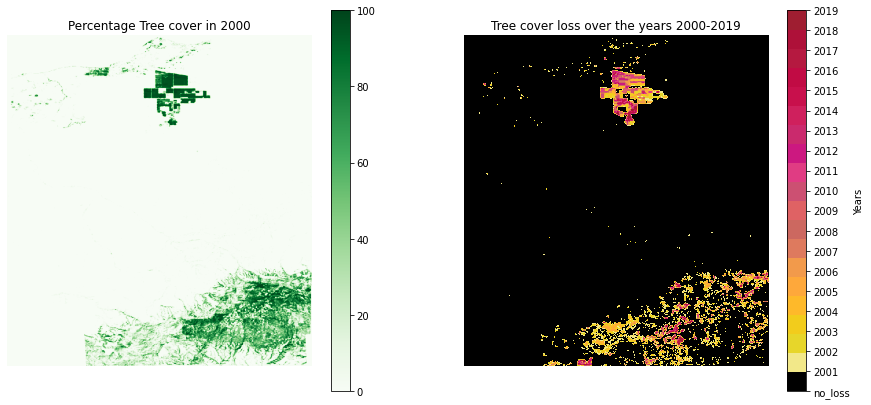

oregon_polk


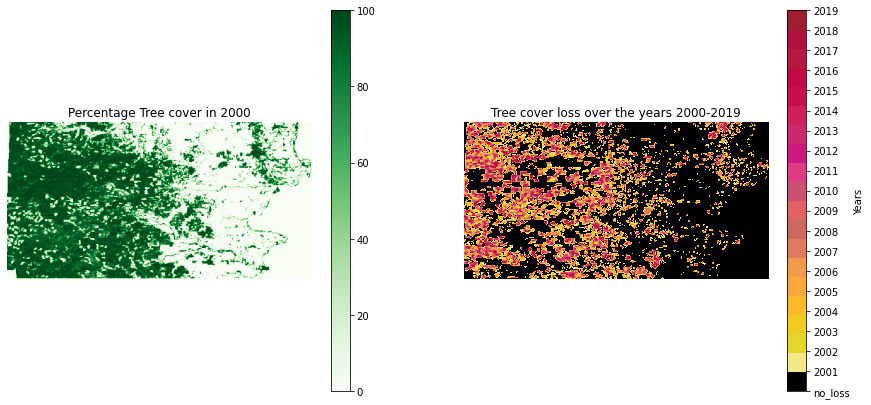

oregon_multnomah


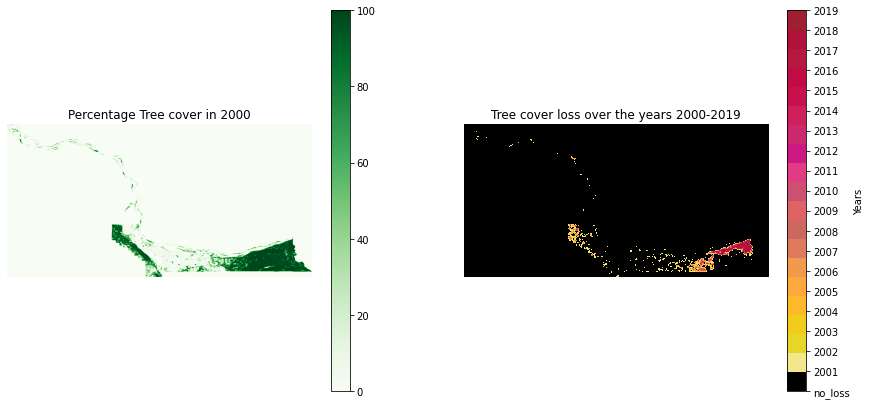

oregon_sherman


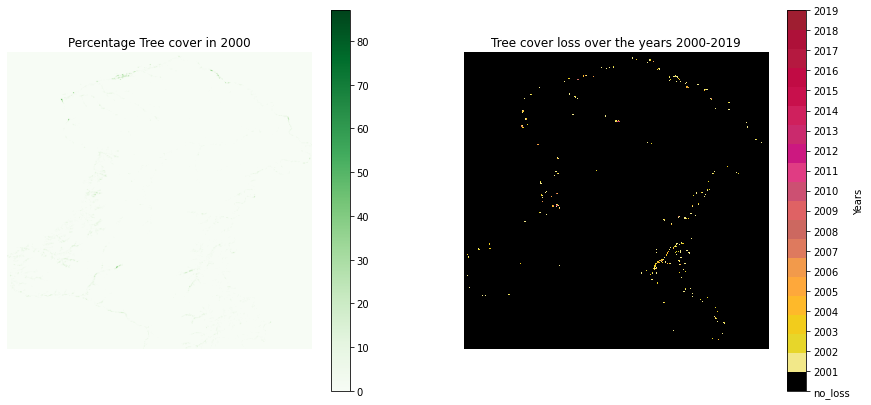

oregon_tillamook


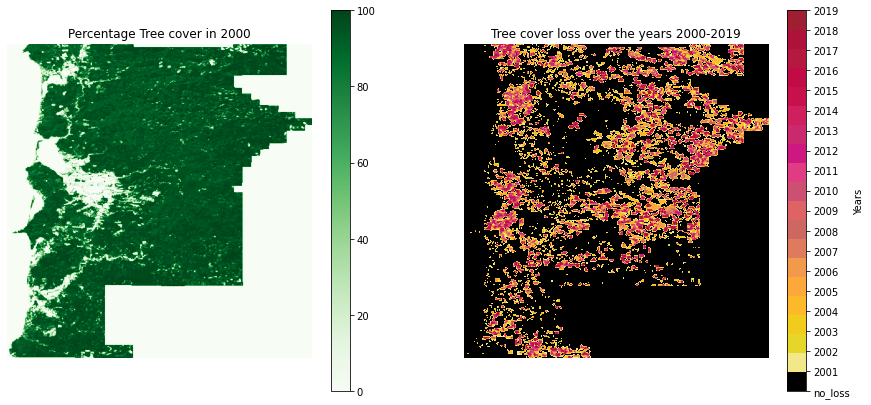

oregon_umatilla


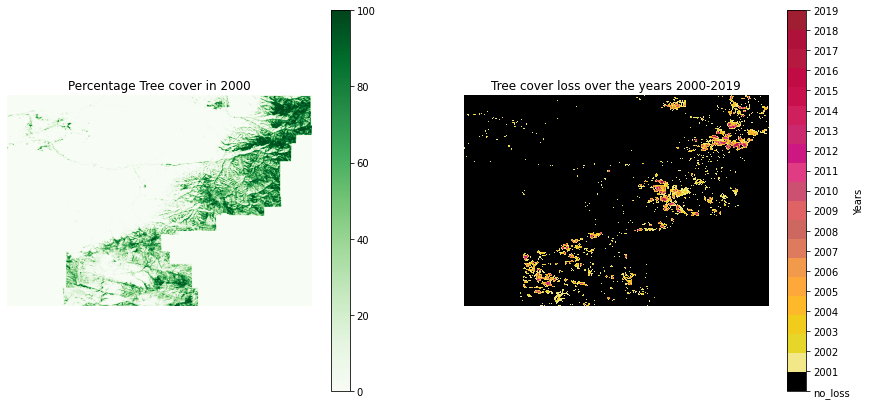

oregon_union


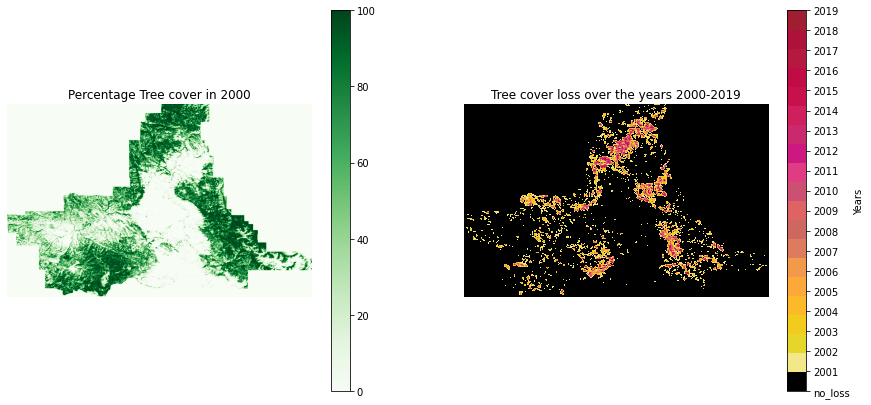

oregon_wallowa


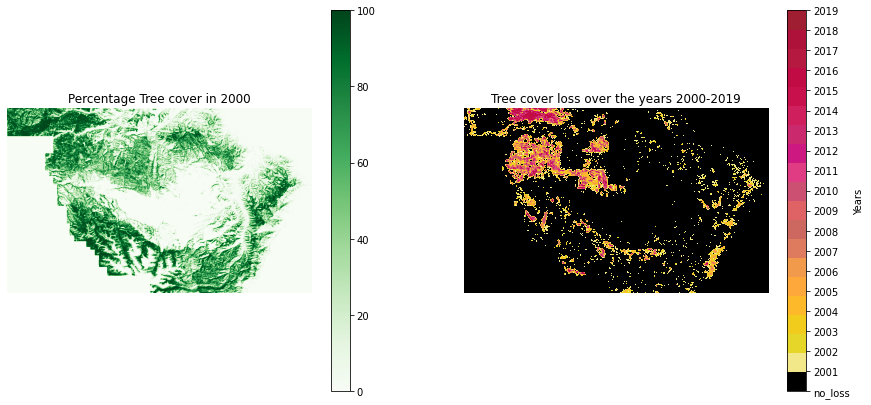

oregon_washington


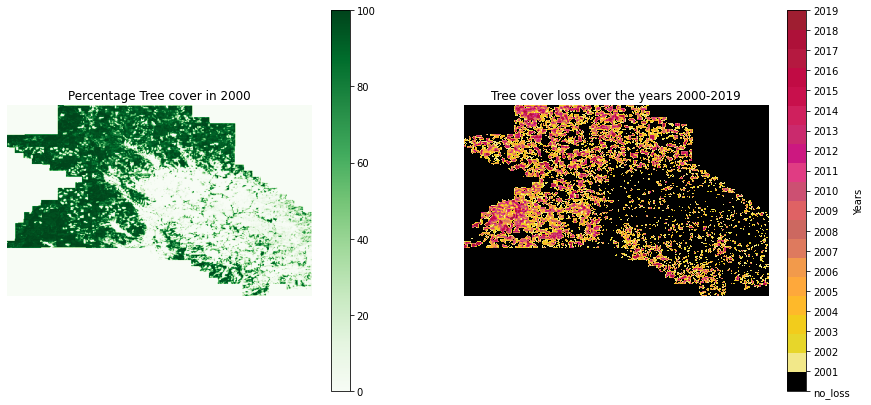

oregon_wasco


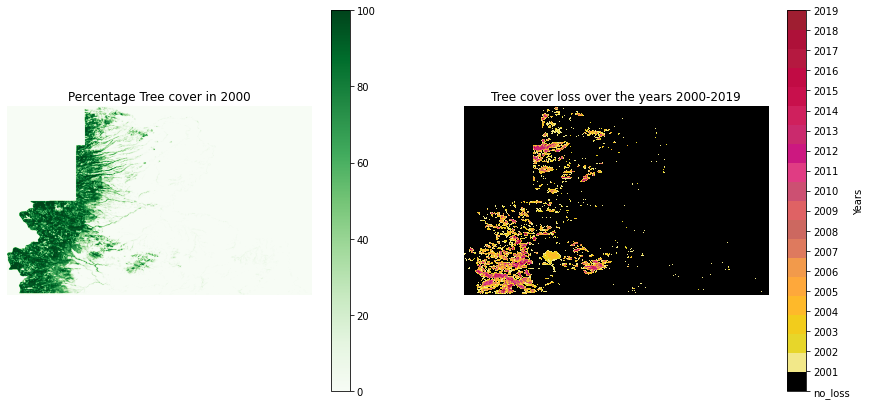

oregon_yamhill


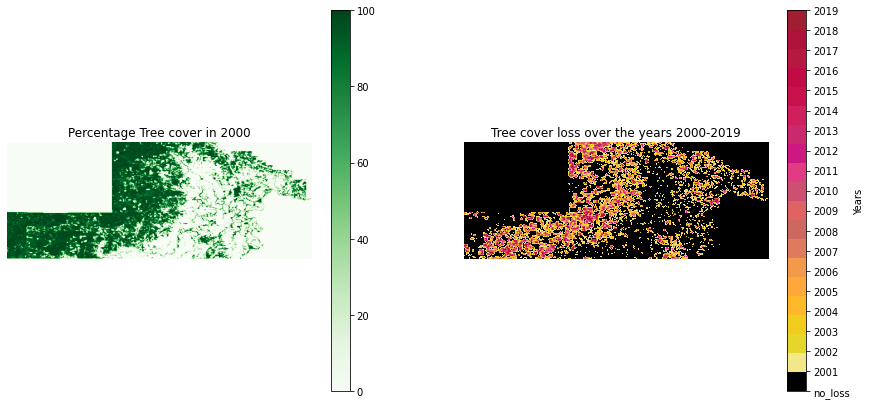

oregon_wheeler


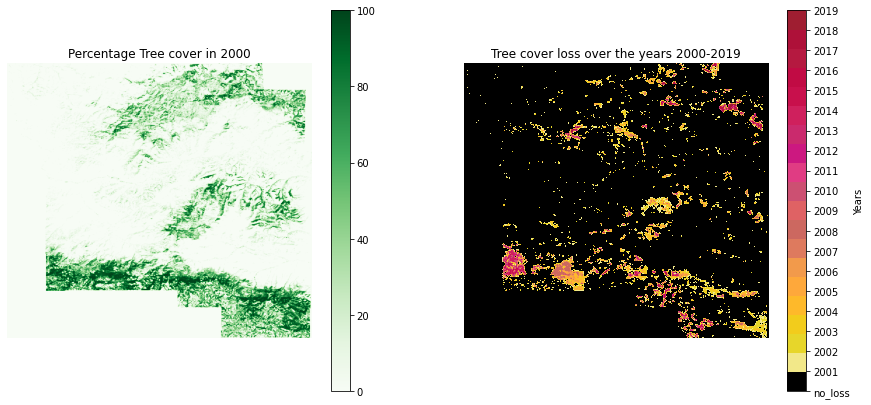

In [23]:
for i in range(len(imgs_paths_counties)):
  print(imgs_paths_counties[i].split("/")[-1].split(".tif")[0])
  display_bands_image_hansen_dataset(imgs_paths_counties[i])

oregon_benton


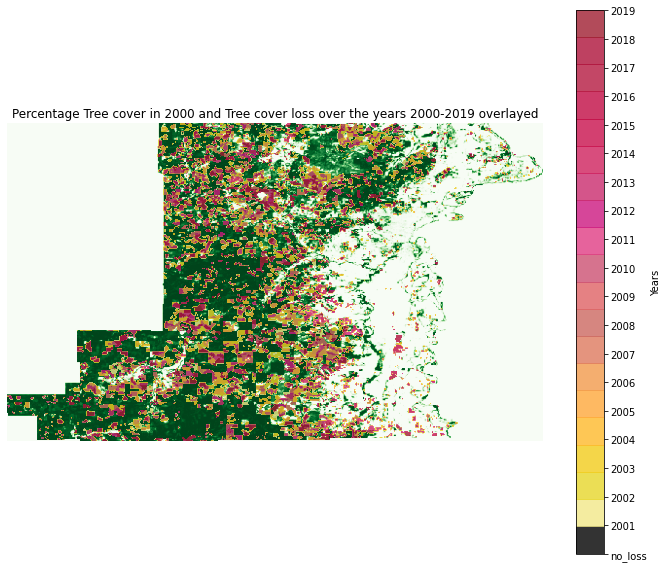

oregon_baker


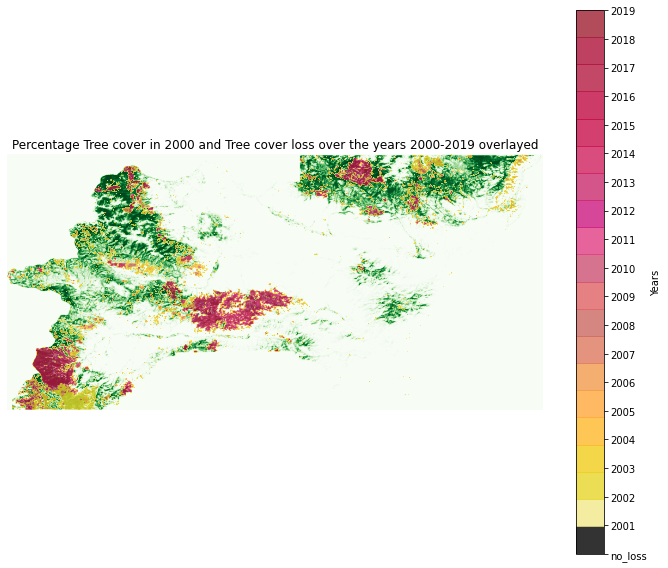

oregon_clackamas


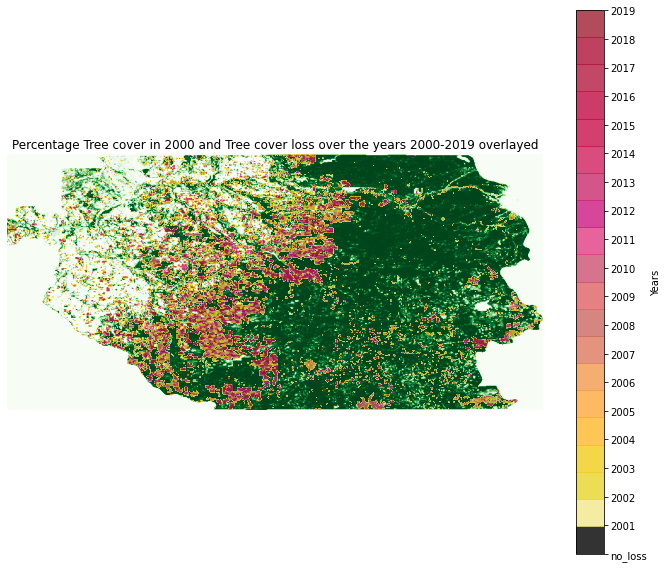

oregon_clatsop


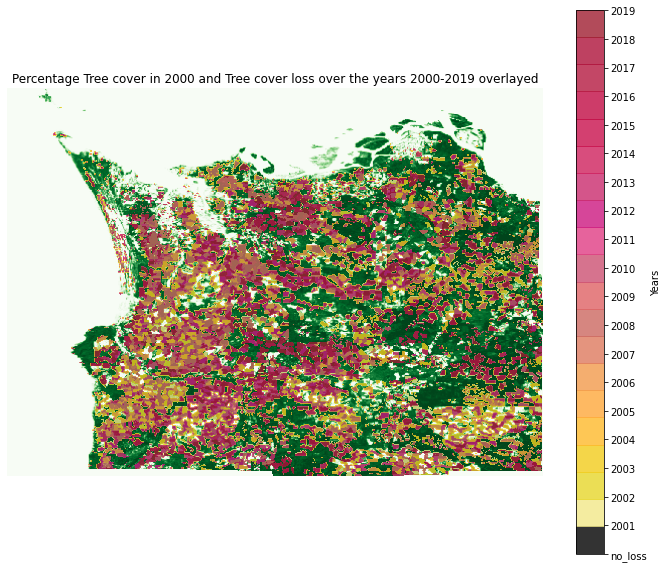

oregon_columbia


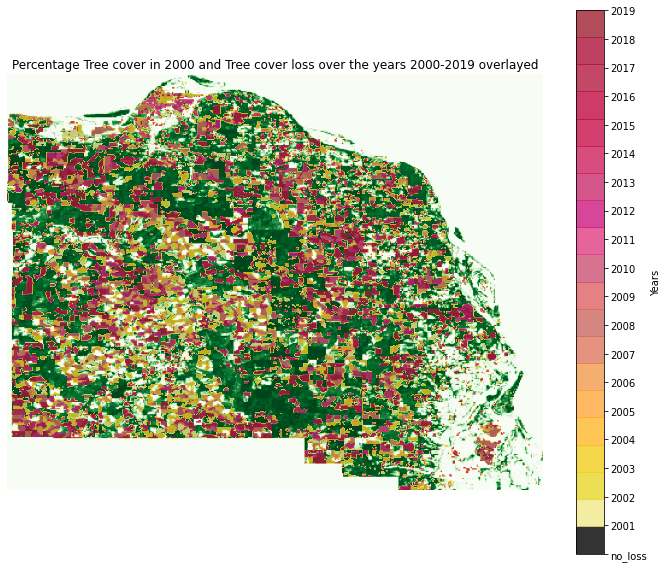

oregon_coos


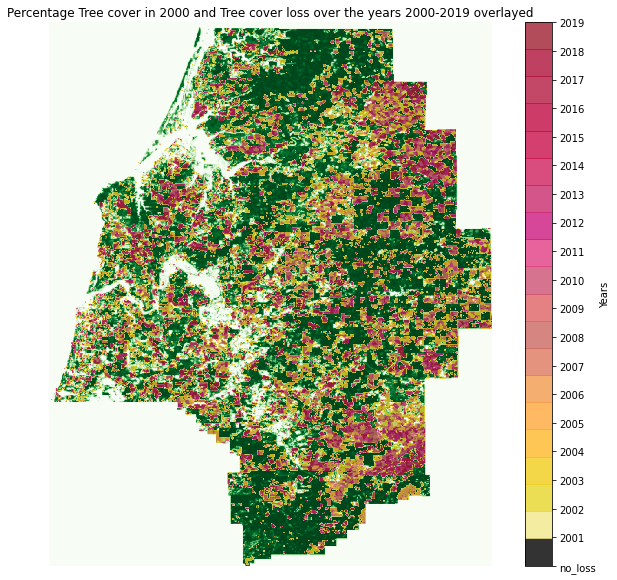

oregon_crook


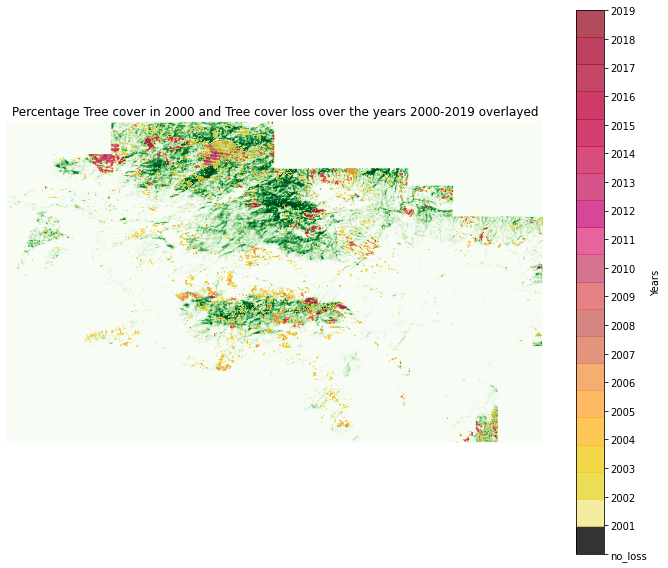

oregon_curry


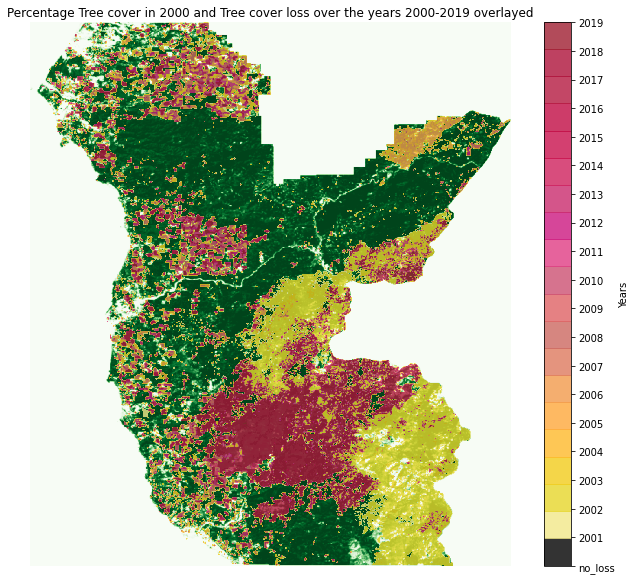

oregon_deschutes


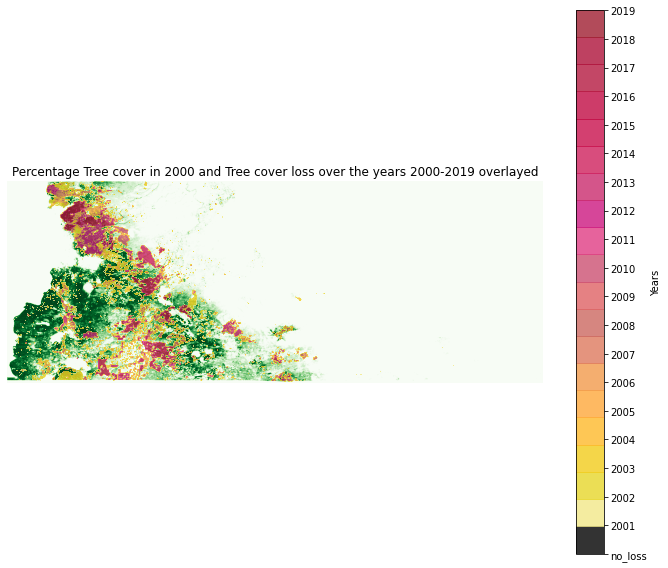

oregon_gilliam


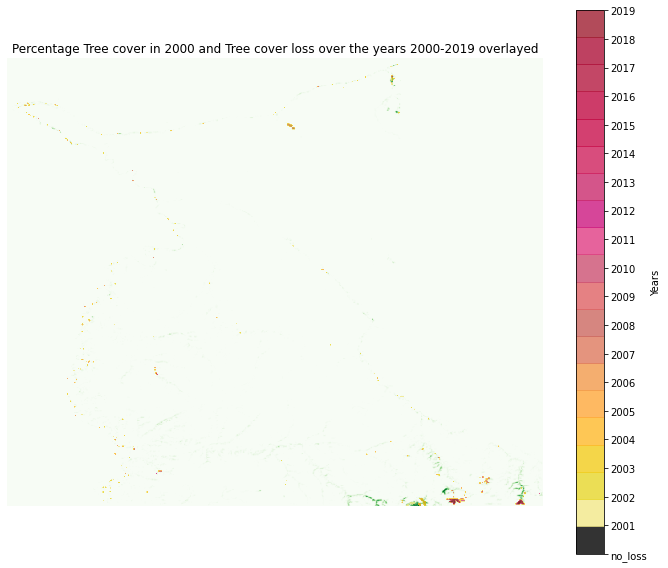

oregon_grant


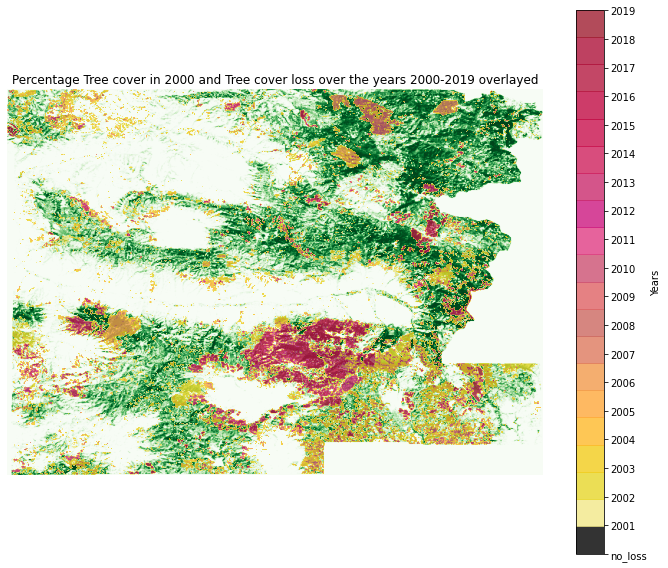

oregon_douglas


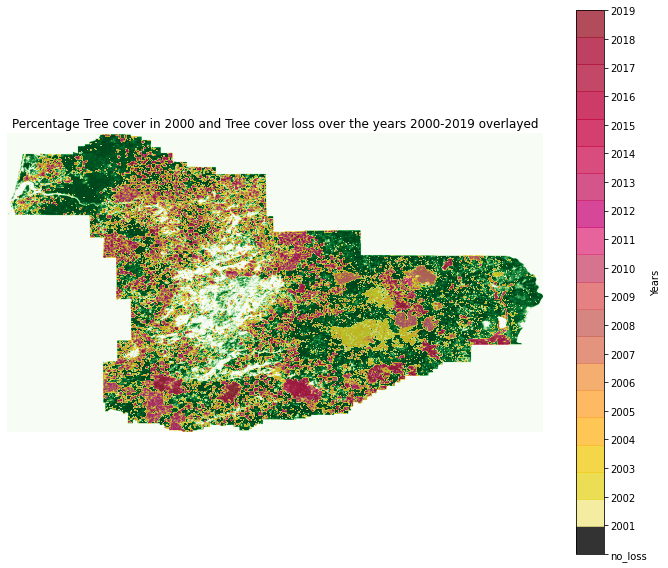

oregon_hood river


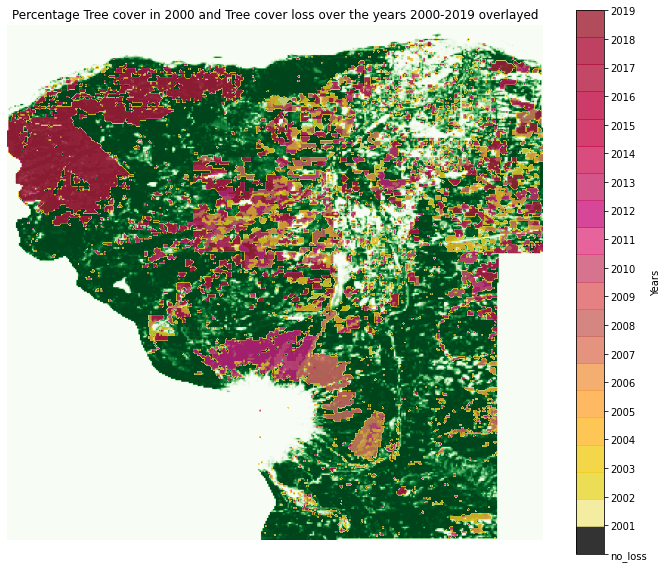

oregon_harney


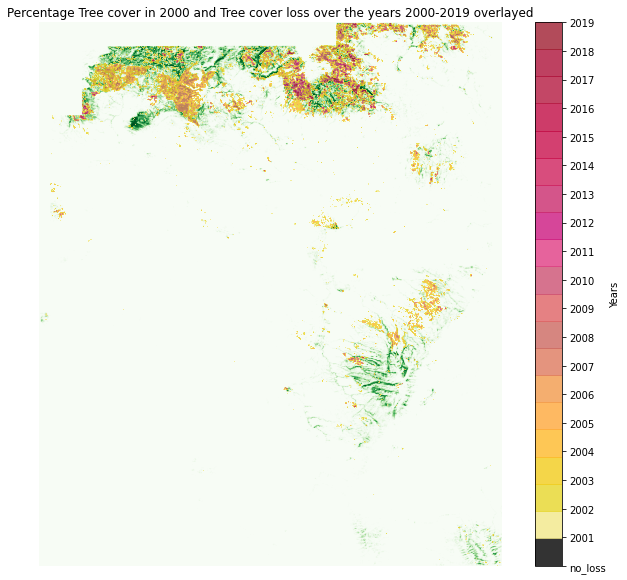

oregon_jackson


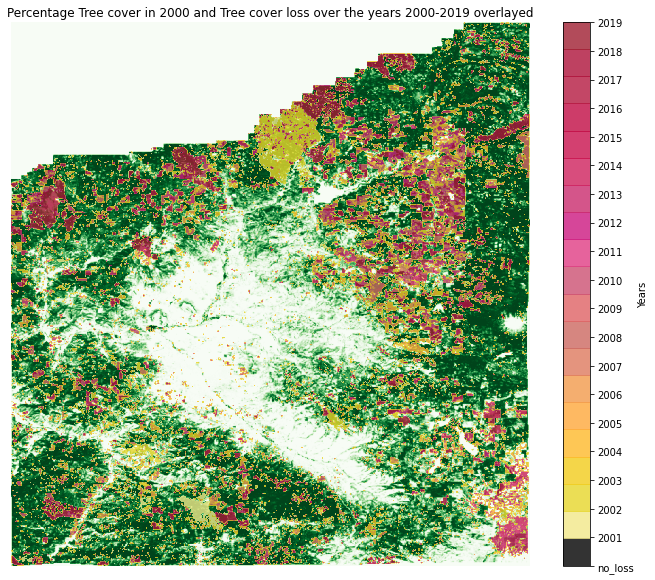

oregon_jefferson


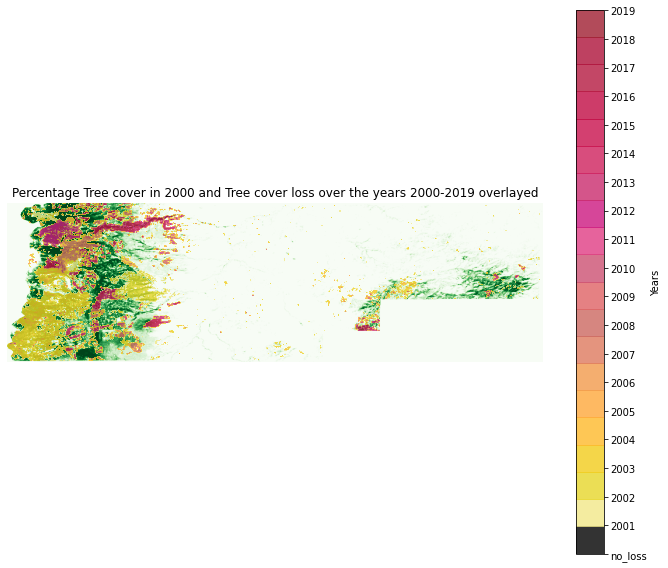

oregon_josephine


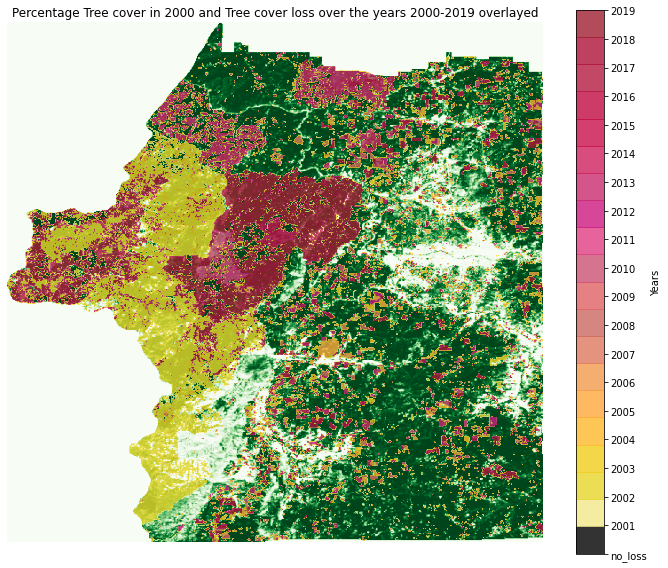

oregon_klamath


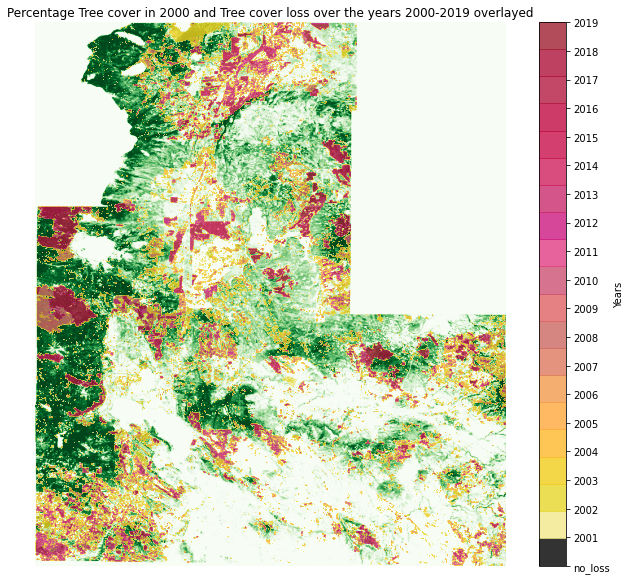

oregon_lane


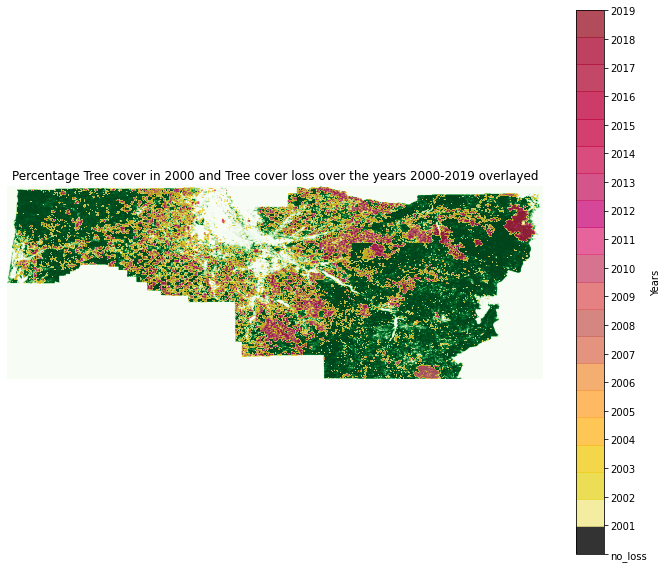

oregon_lincoln


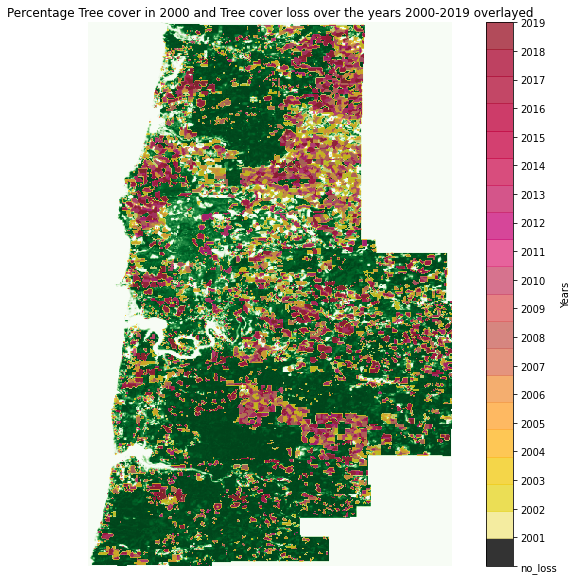

oregon_linn


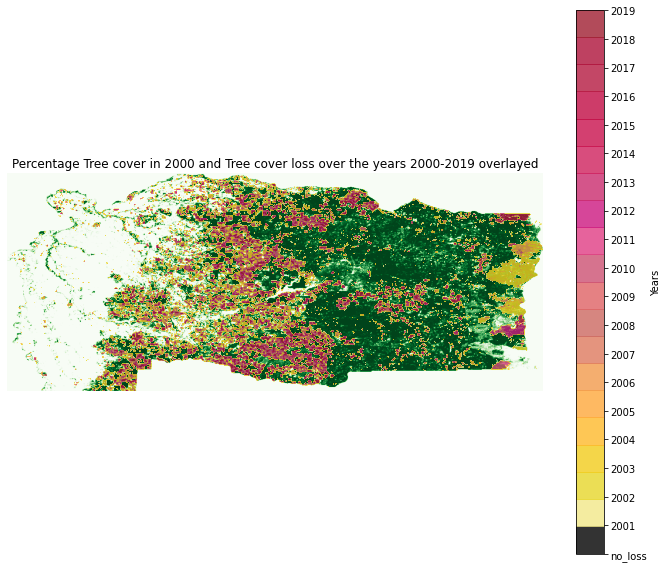

oregon_malheur


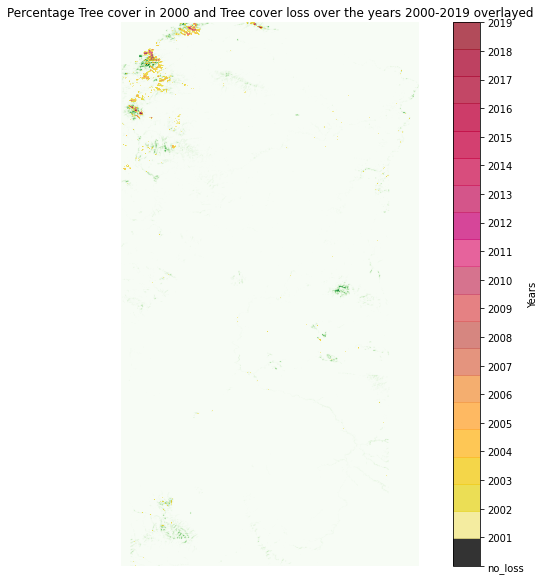

oregon_lake


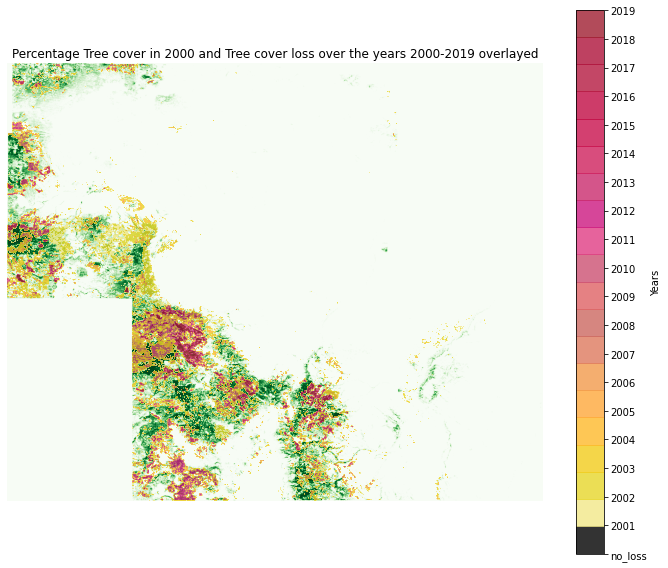

oregon_marion


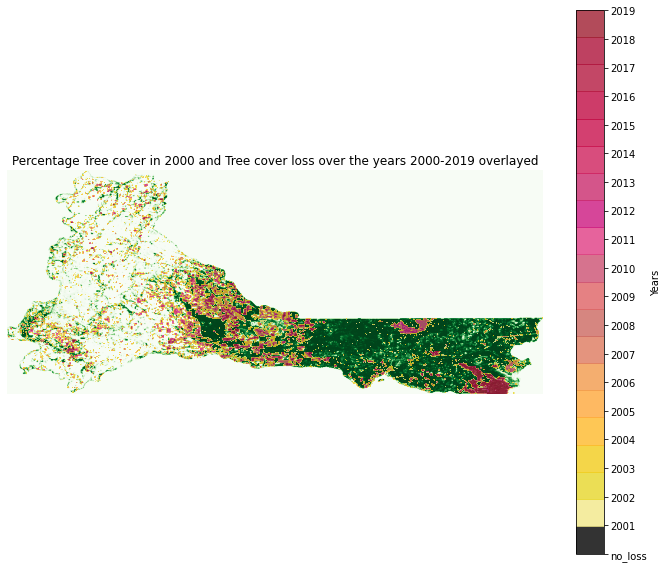

oregon_morrow


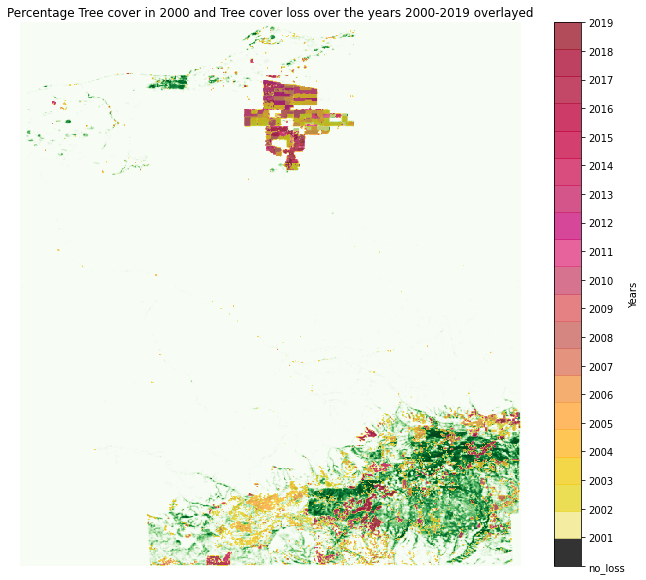

oregon_polk


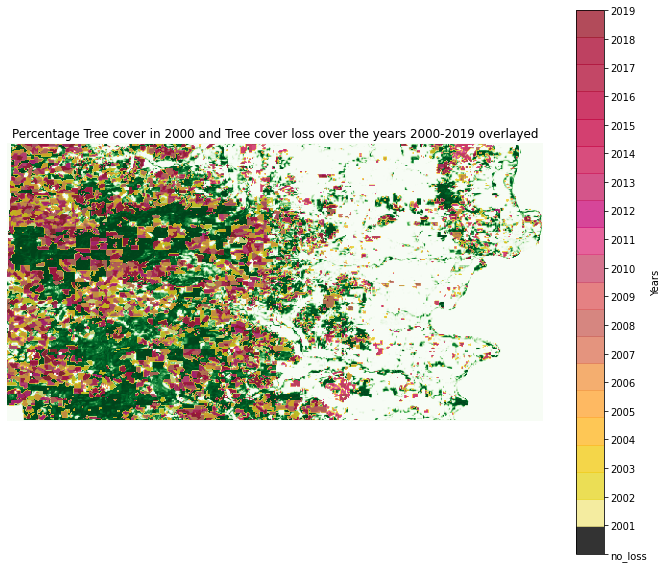

oregon_multnomah


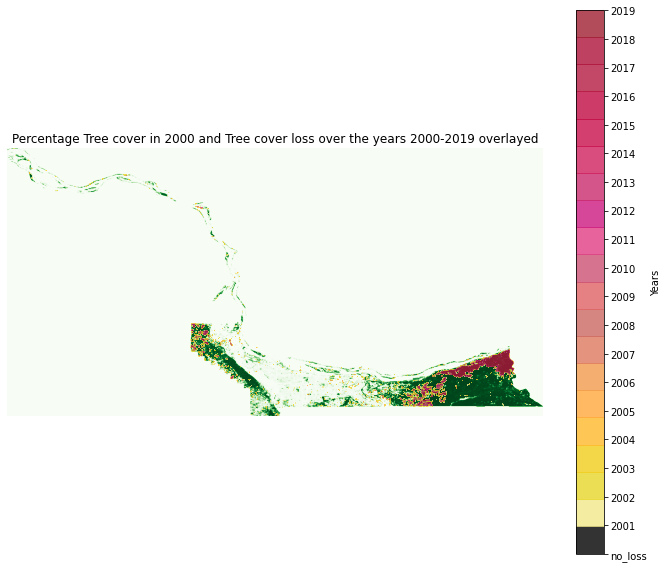

oregon_sherman


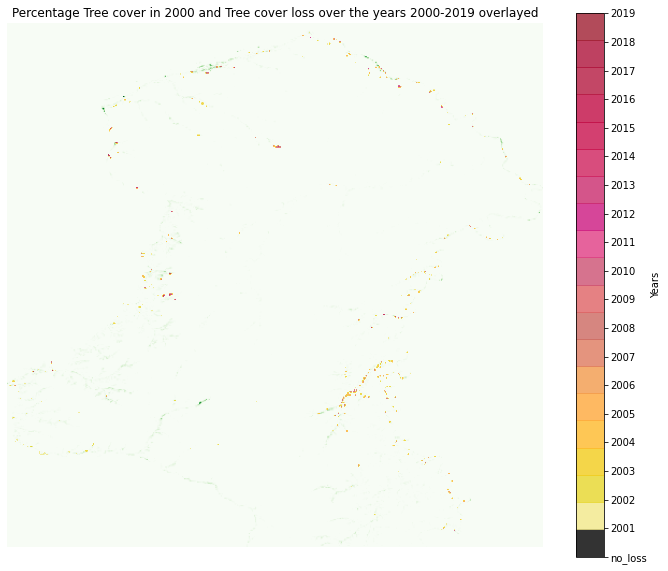

oregon_tillamook


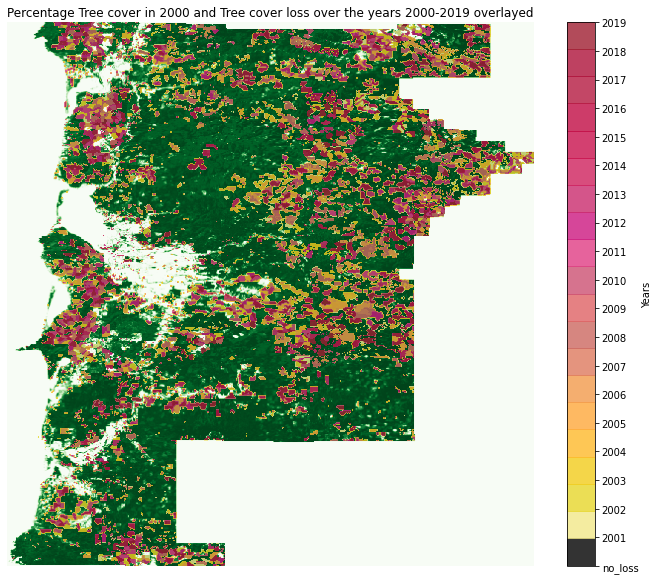

oregon_umatilla


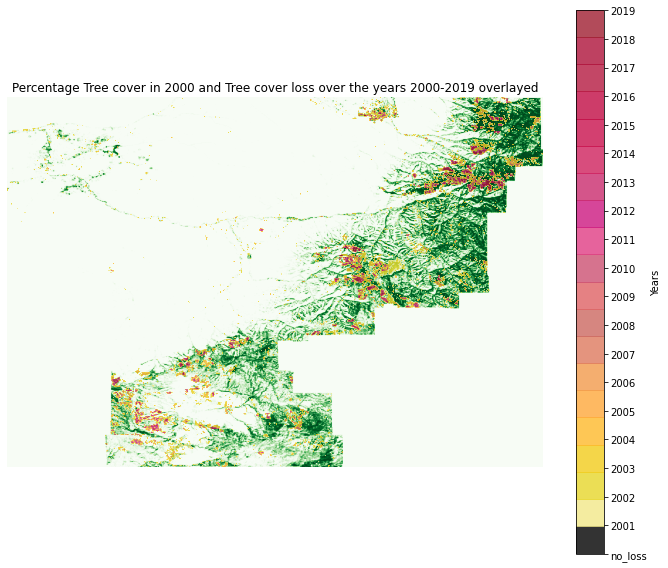

oregon_union


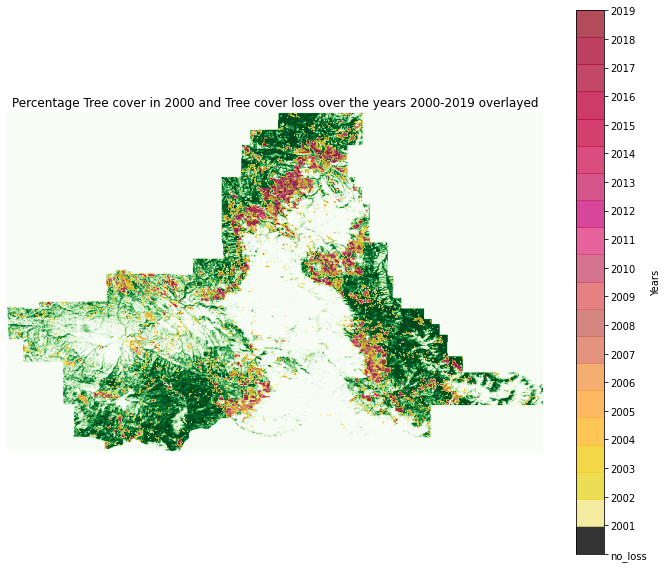

oregon_wallowa


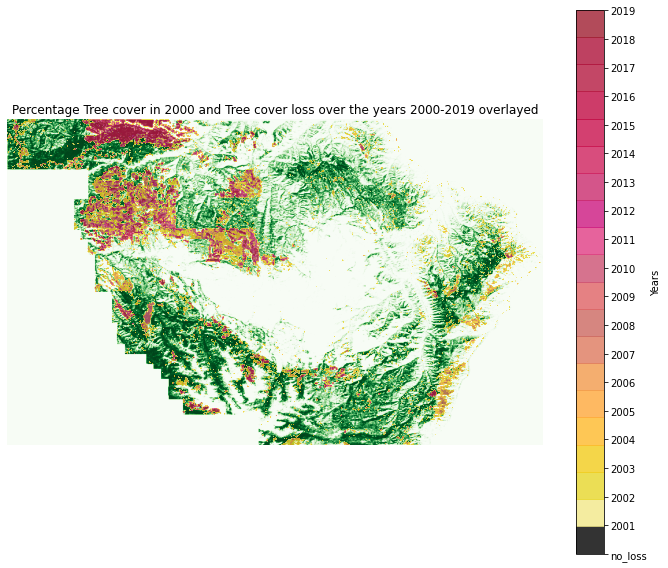

oregon_washington


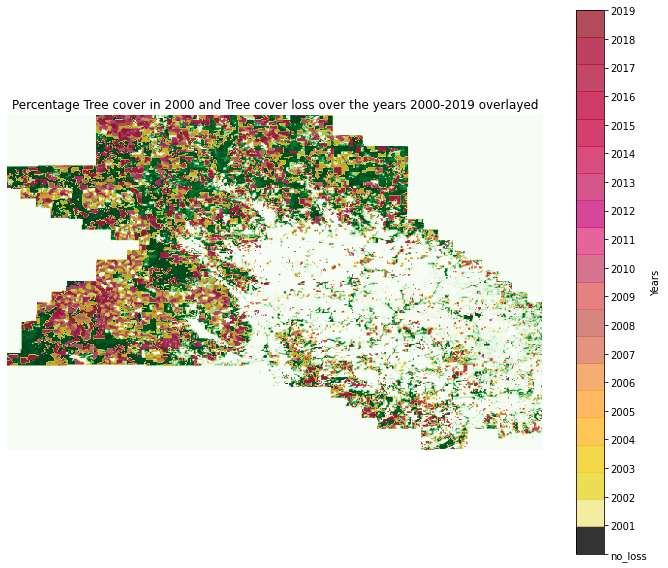

oregon_wasco


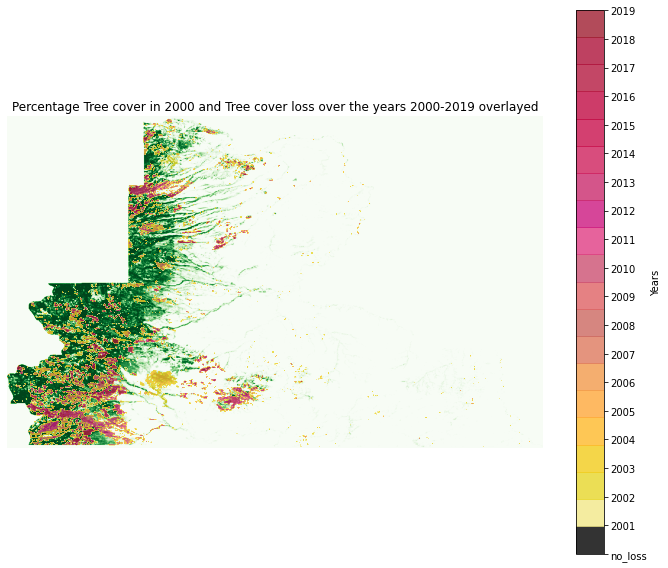

oregon_yamhill


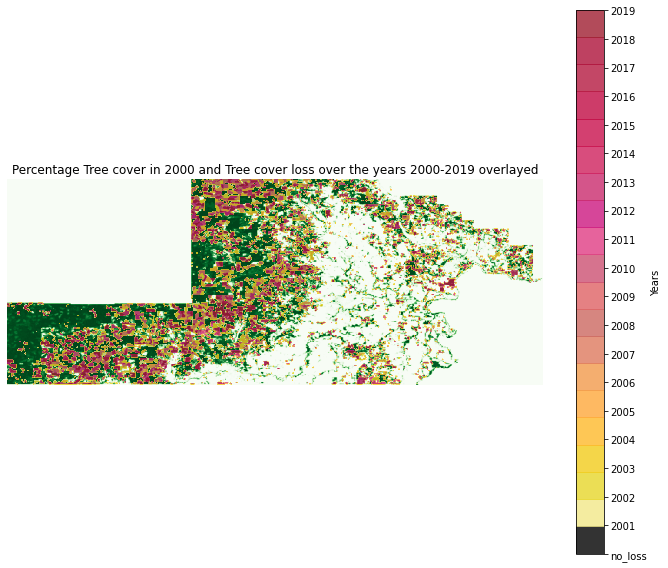

oregon_wheeler


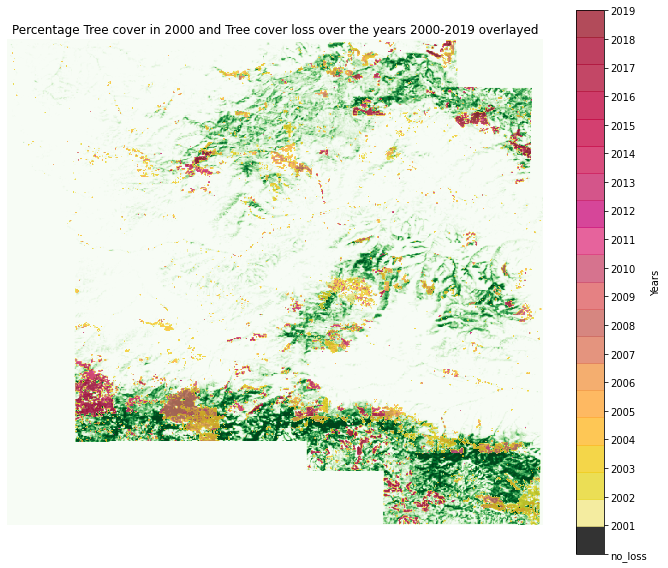

In [24]:
for i in range(len(imgs_paths_counties)):
  name = imgs_paths_counties[i].split("/")[-1].split(".tif")[0]
  print(name)
  display_overlayed_treecover2000_treelossyears(imgs_paths_counties[i], save=True, name=name)

In [25]:
count_per_year = get_loss_per_year(all_imgs)

19


In [26]:
years = [i for i in range(2001,2020)]
count_per_year_pd = pd.DataFrame(count_per_year, columns=years, index=counties) 
count_per_year_pd.head(10)

,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
oregon_benton,77.451478,51.656768,45.213703,59.267218,53.318046,52.195561,43.013632,35.807277,36.839964,30.015254,35.874627,38.231845,44.944307,37.468556,38.456343,41.599301,46.246390,48.446461,37.244059
oregon_baker,425.781081,347.903059,175.624032,252.222422,151.041607,161.368471,116.401714,123.742767,105.648306,119.499773,92.088685,106.344247,85.510922,93.076472,171.583086,340.270160,147.494554,79.988294,133.530838
oregon_clackamas,148.033347,129.198045,107.354483,102.415548,99.699134,100.574673,79.876046,69.212437,65.687833,55.248721,70.604318,73.792176,87.464046,90.809052,95.096945,93.143821,108.274921,104.256424,77.226981
oregon_clatsop,69.818579,60.097857,74.712614,76.306543,71.165561,94.805099,51.275123,191.338825,60.838697,68.381798,51.634319,112.944460,78.169868,81.694472,81.357726,88.990626,90.360058,81.425075,67.349111
oregon_columbia,92.941774,66.810318,65.126591,71.277809,57.493691,66.496022,47.930118,51.477171,44.405514,40.140070,40.027822,57.987585,52.913952,63.151017,58.010034,65.912330,65.283738,59.603963,58.997821
oregon_coos,154.004968,142.173974,126.975524,141.298435,146.843512,160.874577,119.656921,124.977501,97.364365,98.172554,129.557240,106.658543,110.721939,111.036235,94.647951,115.301678,101.248164,112.450566,89.260022
oregon_crook,560.771150,297.346326,179.215985,268.835202,129.557240,129.287844,119.163027,109.487205,95.523489,96.556176,91.504992,120.105915,89.551868,94.356105,106.546294,110.272945,100.260377,98.060306,99.025643
oregon_curry,64.273502,810.052660,168.552376,54.373182,76.306543,99.631785,57.807987,65.216389,42.295242,46.201490,64.565348,50.489384,59.761111,63.779608,55.652816,75.318756,407.192727,320.896065,91.796839
oregon_deschutes,279.229415,294.495214,199.645215,188.824458,151.108956,158.786755,121.632495,130.612376,124.416258,131.802211,109.644353,164.825725,162.378707,188.779559,99.833833,127.244921,205.482138,225.844020,145.384281
oregon_gilliam,114.291442,43.215680,25.502863,19.688390,14.951503,12.190189,9.630923,7.273704,6.128769,5.612426,4.445041,3.210308,3.232757,2.873562,2.424568,1.773527,1.661278,1.593929,2.985811


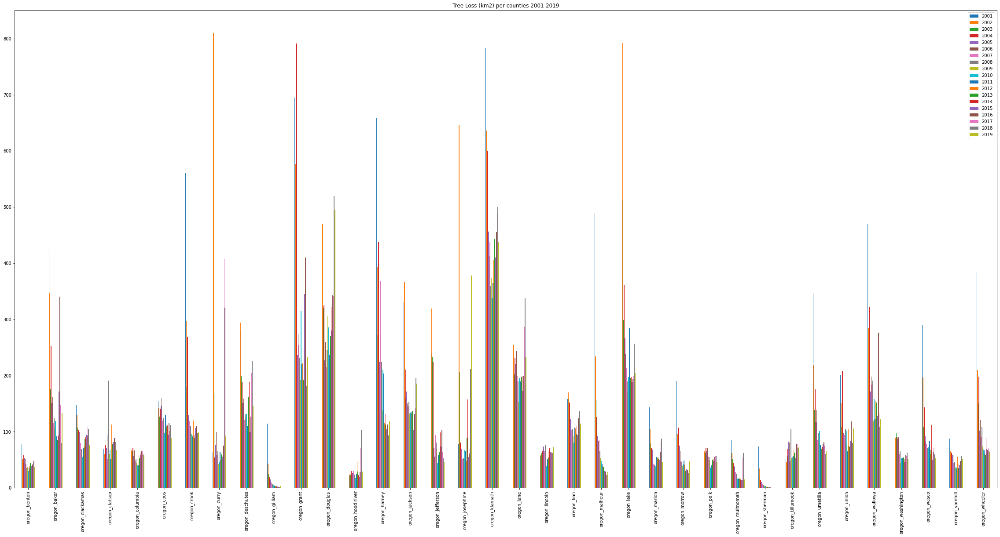

In [27]:
fig = count_per_year_pd.plot.bar(figsize=(40, 20), title="Tree Loss (km2) per counties 2001-2019").get_figure()

In [28]:
fig.savefig('Tree_Loss_per_counties_2001_2019.png')

We see here that in some counties have a significant decrease in Tree Loss, like Gilliam, Sherman, Malheur. Let's take a look at them again:

oregon_gilliam


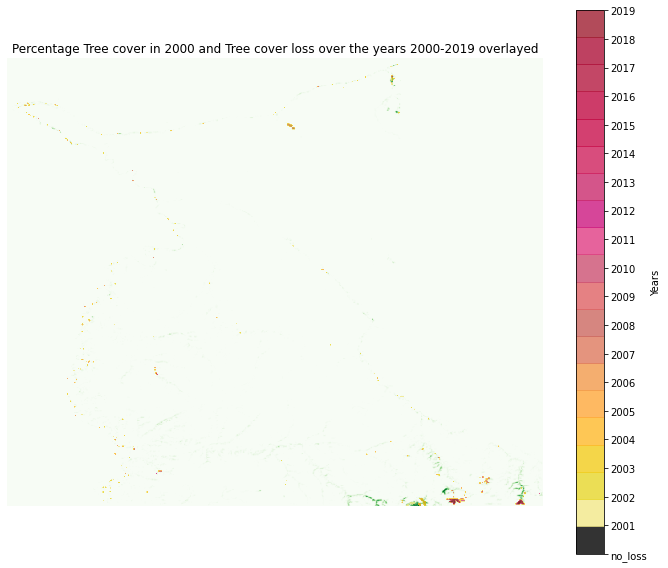

oregon_malheur


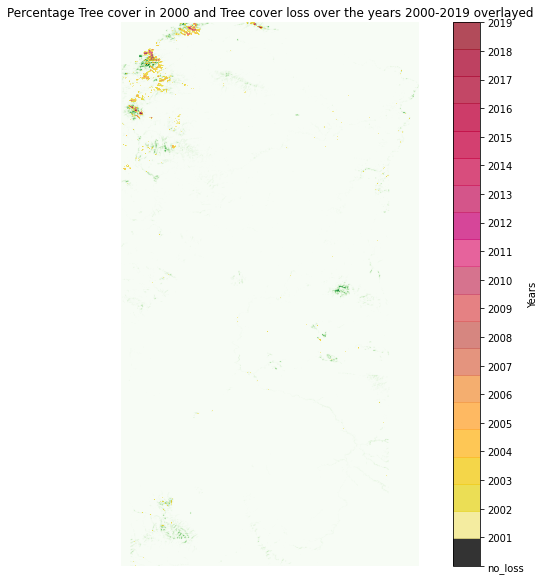

oregon_sherman


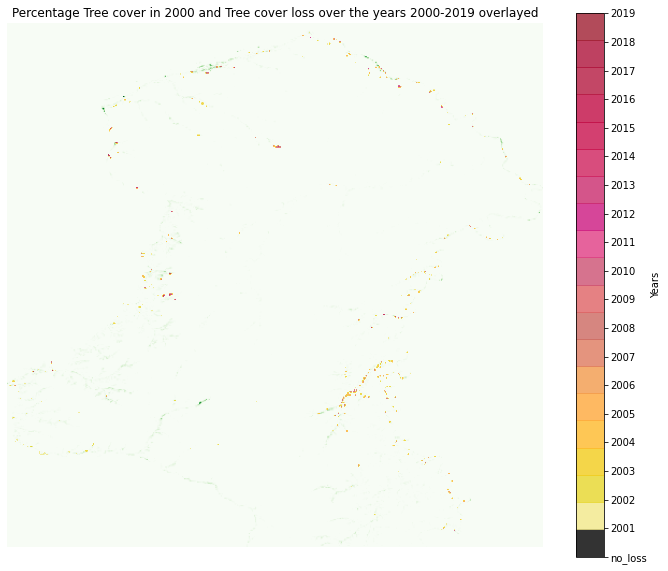

In [31]:
for i in range(len(imgs_paths_counties)):
  name = imgs_paths_counties[i].split("/")[-1].split(".tif")[0]
  if 'gilliam' in name or 'sherman' in name or 'malheur' in name:
    print(imgs_paths_counties[i].split("/")[-1].split(".tif")[0])
    display_overlayed_treecover2000_treelossyears(imgs_paths_counties[i])

# More visualisations

So the tree loss decreased in these regions because the tree cover in really low and probably most of the trees are gone 

In [32]:
folder_name_treecover = "copernicus_oregon"
landcover_exported = True
if not landcover_exported:
  export_landcover_Copernicus_tree_coverage_image(collection, folder_name_treecover, scale=150)

In [33]:
path_drive = '/content/drive/MyDrive/' + folder_name_treecover
imgs_paths = glob.glob(path_drive + "/*.tif")
if len(imgs_paths) == 0:
  print("Please, wait until tif is downloaded in your Drive, and re try")
else:
  print(len(imgs_paths))

5


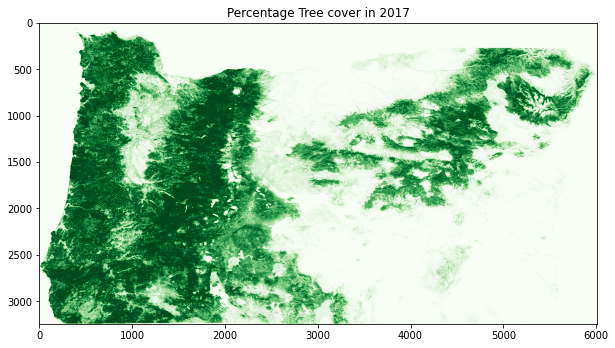

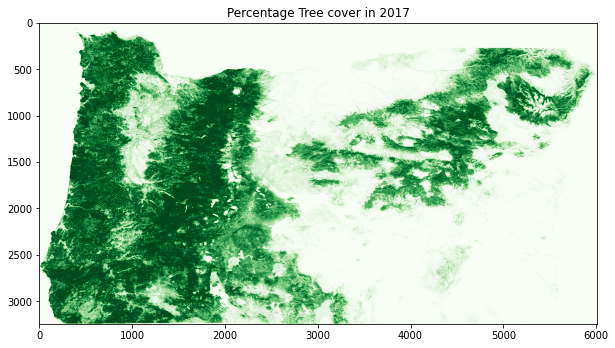

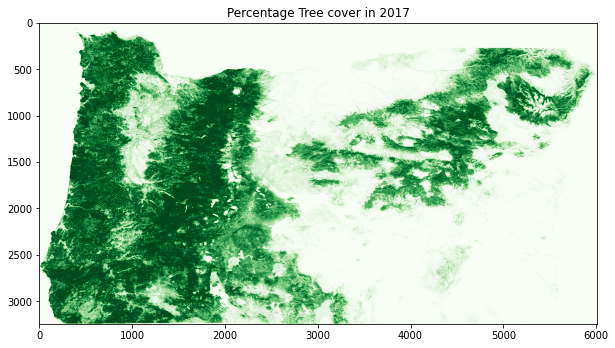

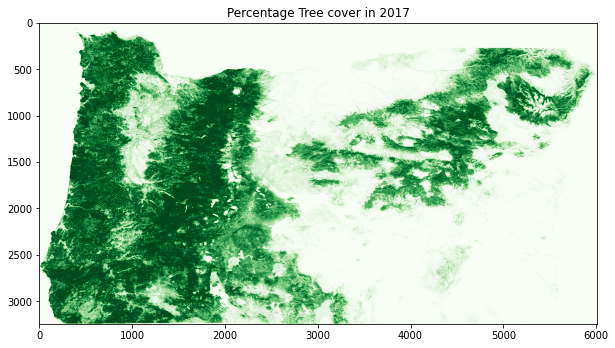

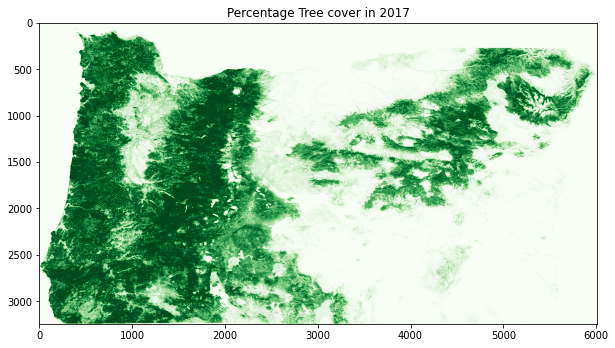

In [34]:
tree_cover_imgs = []
for img_path in imgs_paths:
  img_treecover = rasterio.open(img_path).read()
  tree_cover_imgs.append(img_treecover)

for i in range(len(tree_cover_imgs)):
  plt.figure(figsize=(10,10))
  plt.title("Percentage Tree cover in {}".format(img_path.split("_")[-1].split(".tif")[0]))
  plt.imshow(img_treecover[0], cmap="Greens")
  plt.show()

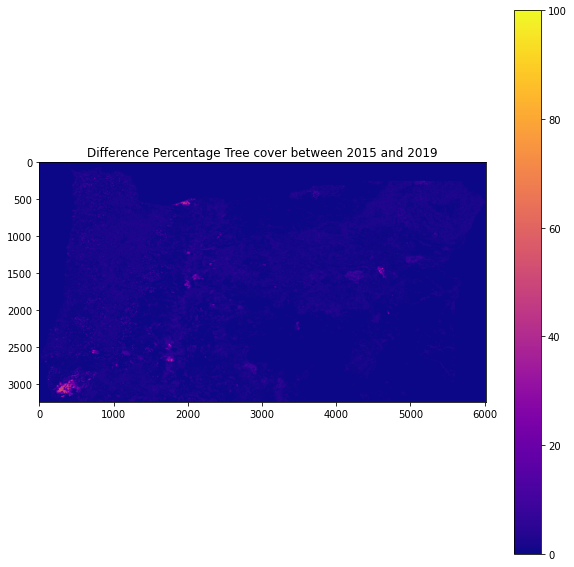

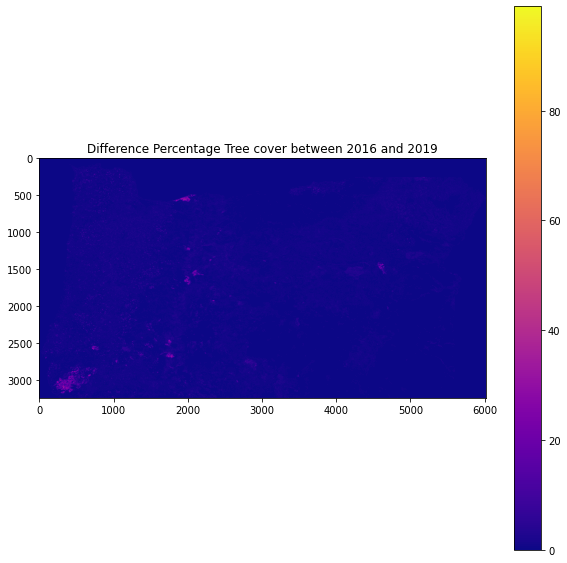

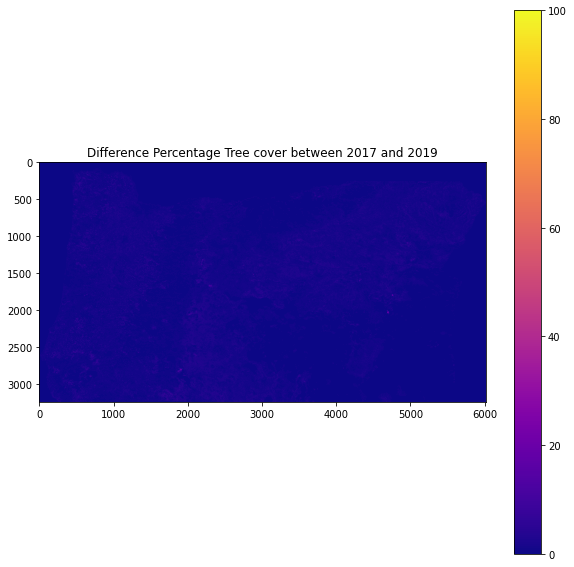

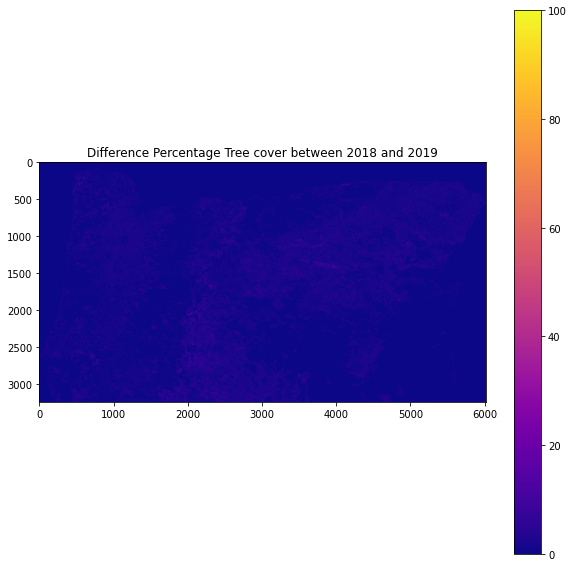

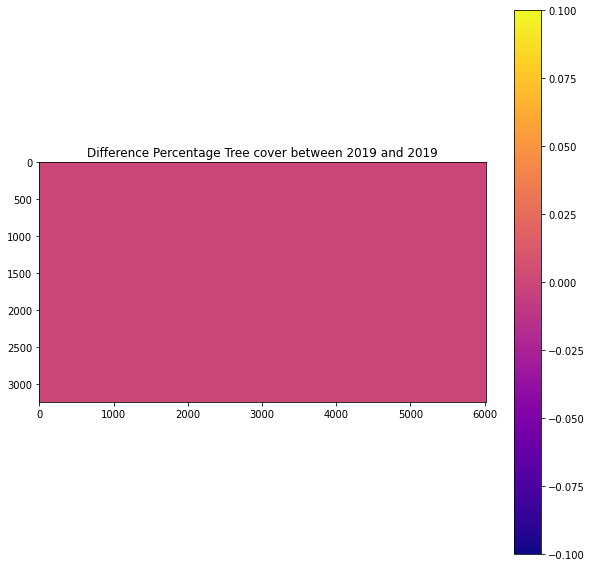

In [37]:
years_copernicus = [2015,2016,2017,2018,2019]
for i in range(len(tree_cover_imgs)):
  fig, ax = plt.subplots(figsize=(10,10))
  ax.title.set_text('Difference Percentage Tree cover between {} and {}'.format(years_copernicus[i], years_copernicus[-1]))
  difference = cv2.subtract(tree_cover_imgs[i], tree_cover_imgs[-1])
  pos = ax.imshow(difference[0], cmap="plasma")
  fig.colorbar(pos, ax=ax)
plt.show()

# Link to CO2 TODO

A mature tree absorbs carbon dioxide at a rate of 48 pounds per year. In one year, an acre of forest can absorb twice the CO2 produced by the average car's annual mileage.
http://www.tenmilliontrees.org/trees/


According to the Arbor Day Foundation, in one year a mature tree will absorb more than 48 pounds of carbon dioxide from the atmosphere and release oxygen in exchange.

Individual emissions can be assigned years based on Hansen loss during further analyses but removals and net flux are cumulative over the entire model run and cannot be assigned specific years